## Germany & neighbors Wind Cut Scenarios due to wind drought with 130 €/t CO2 price. Transmission Expansion is not allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [7]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\'


In [8]:
#solve network
#n.optimize(solver_name='gurobi')
filename = "base_DE_20nodes_1.0_solved.nc"
n = import_nc_file(dir, filename)
contingency = 'wind'
n.name = f'base_{contingency}'

INFO:pypsa.io:Imported network base_DE_20nodes_1.0_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export model for later use

In [9]:
#file = "base_DE_20nodes_1.0_solved.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

In [10]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [11]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


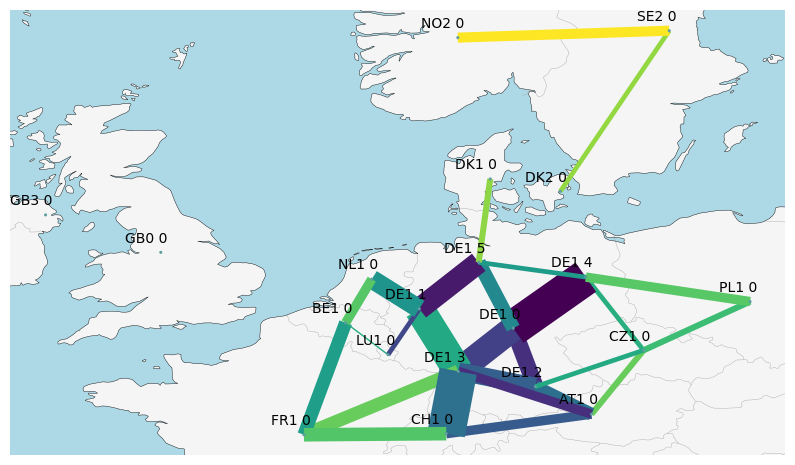

In [12]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [13]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


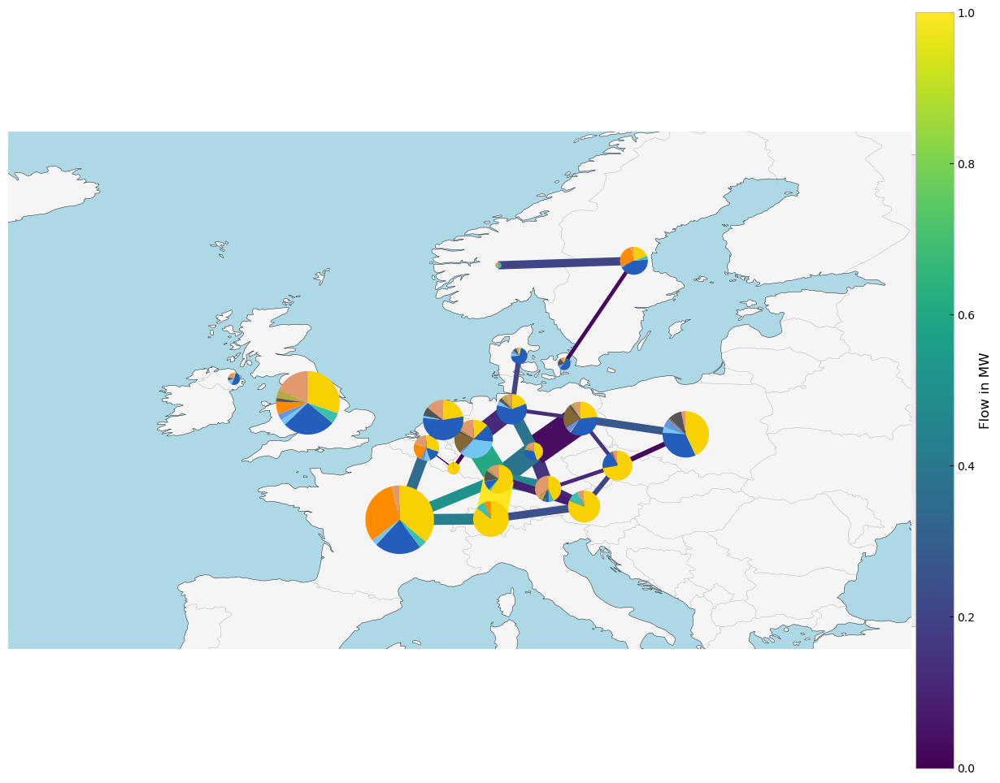

In [14]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [15]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


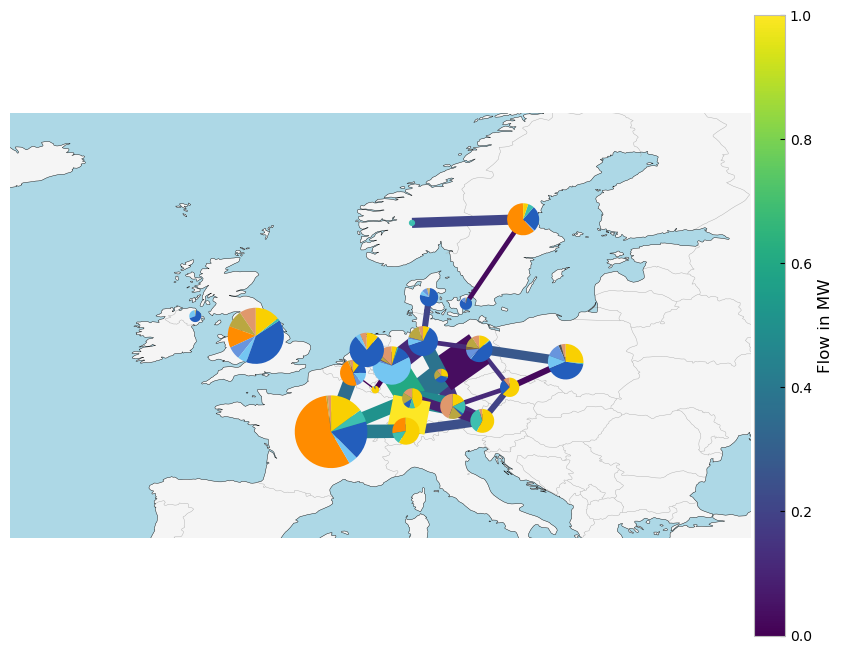

In [16]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

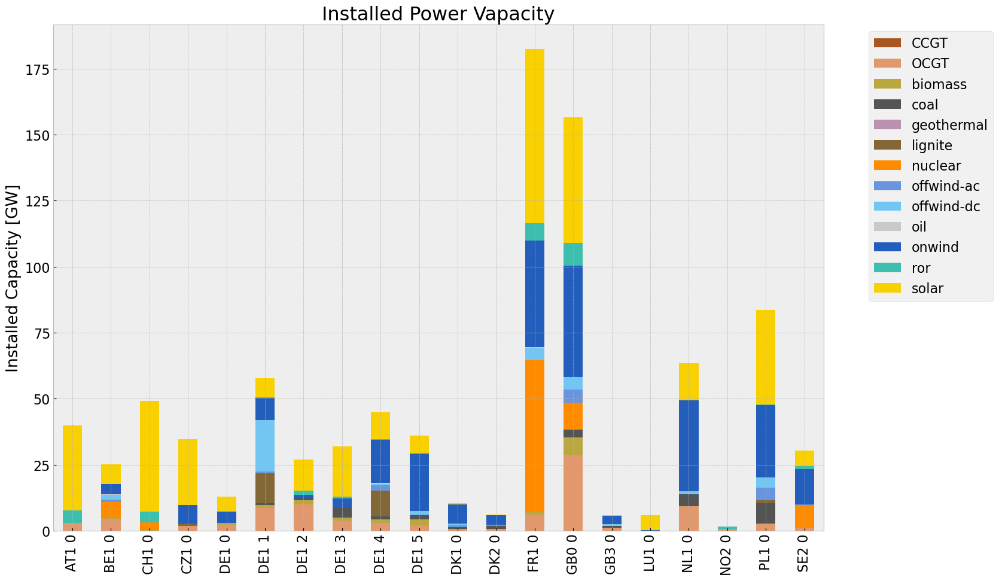

In [17]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

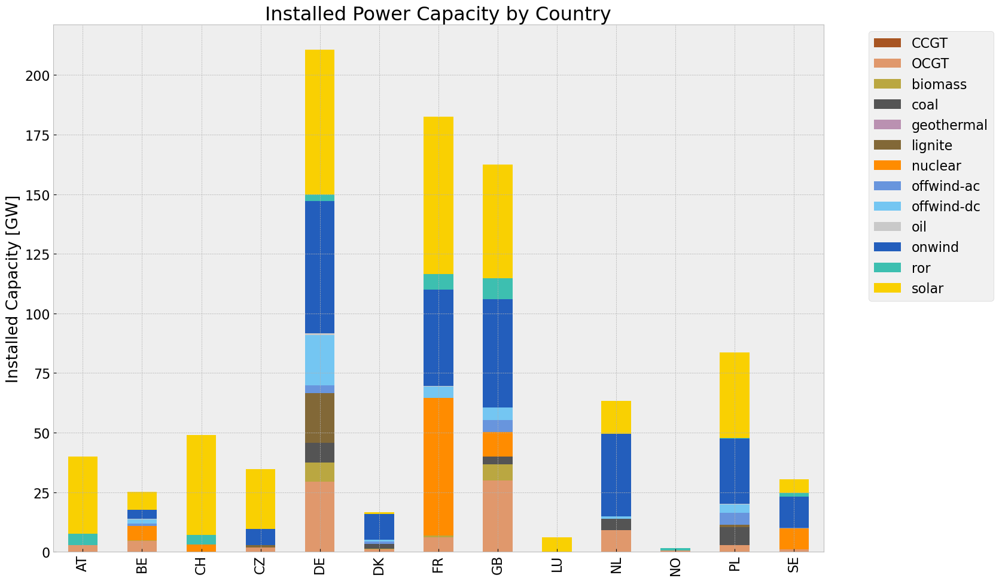

In [18]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

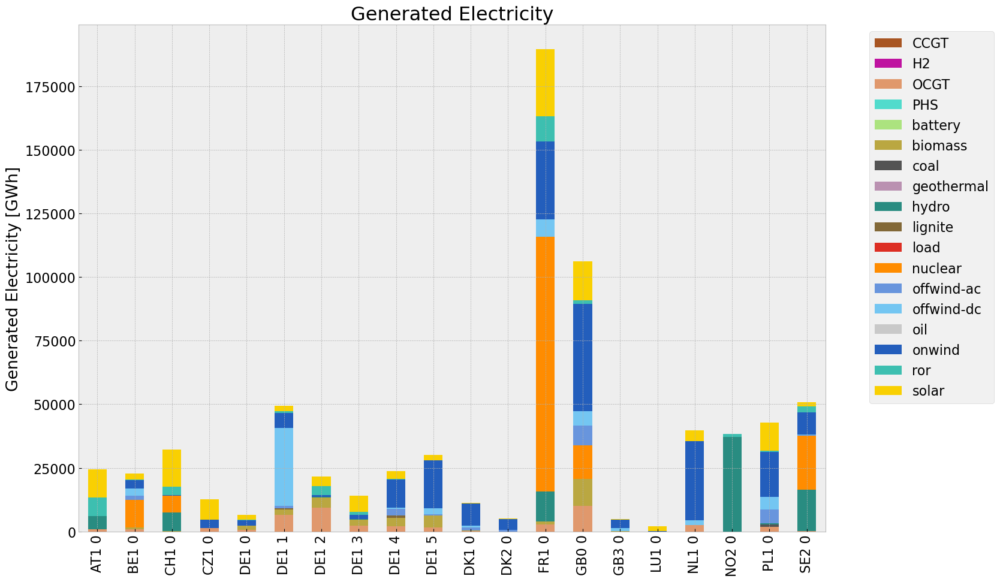

In [19]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

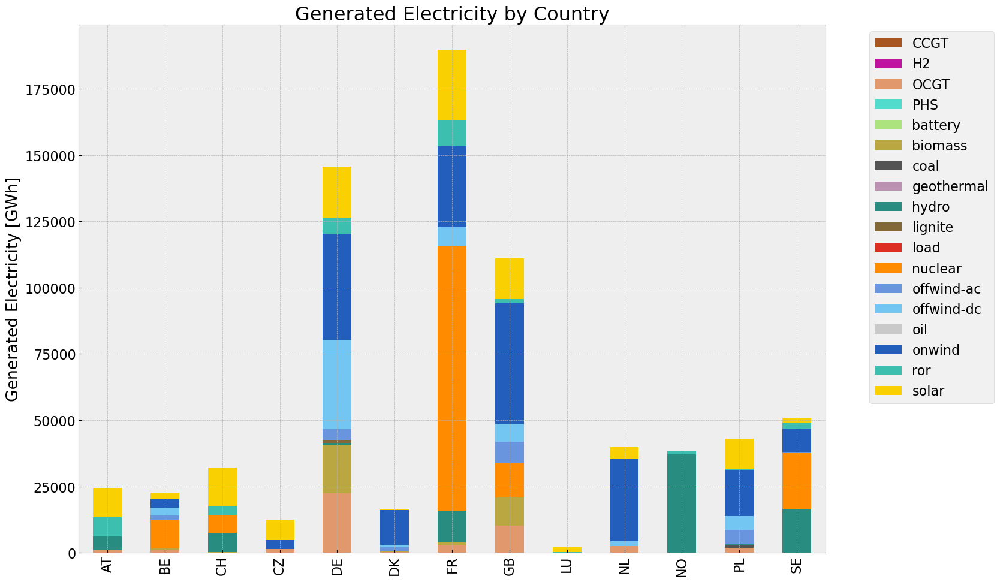

In [20]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [21]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [22]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [23]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [24]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [25]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [26]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [27]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pandas\plotting\_matplotlib\core.py:1794: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(None, 0)
C:\Users\Jeremy\AppData\

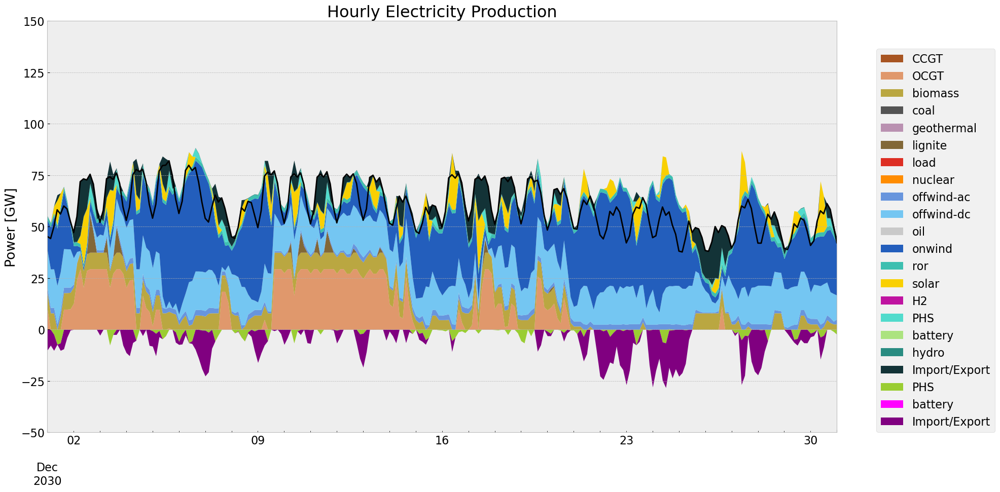

In [28]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

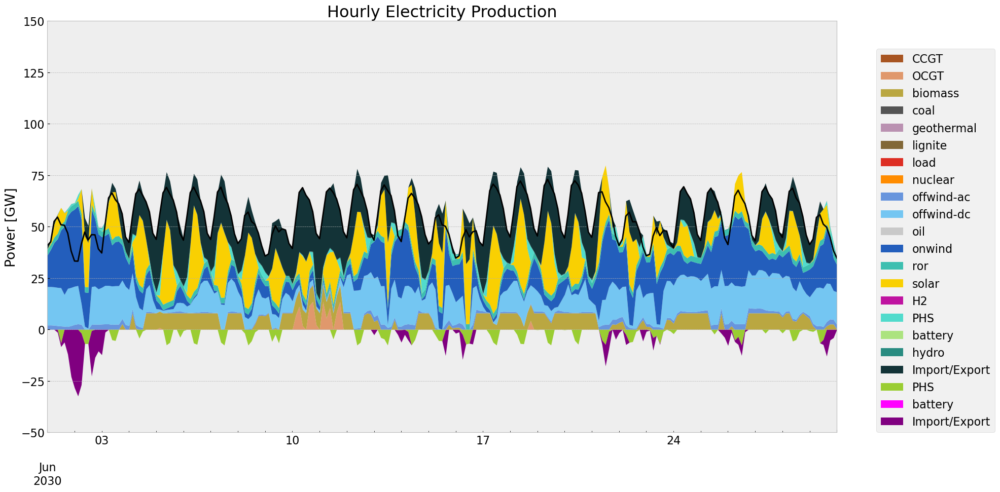

In [29]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [30]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

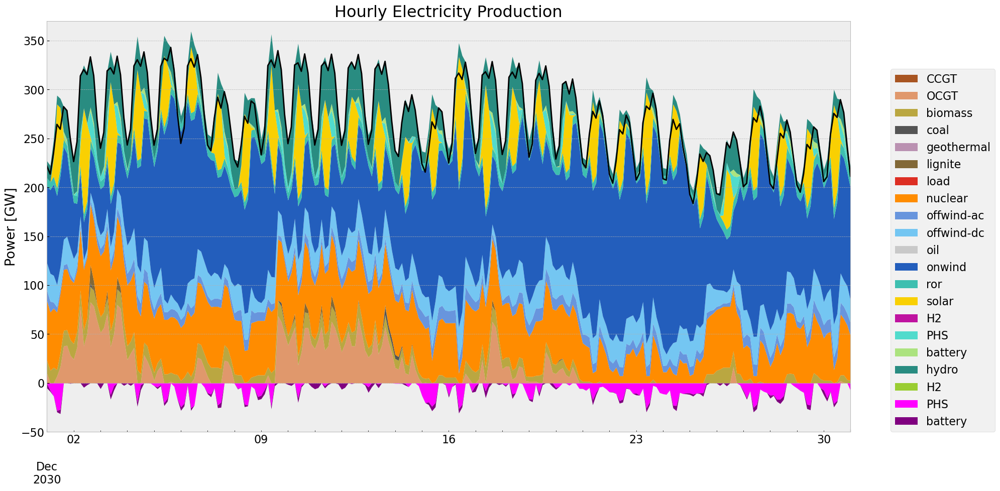

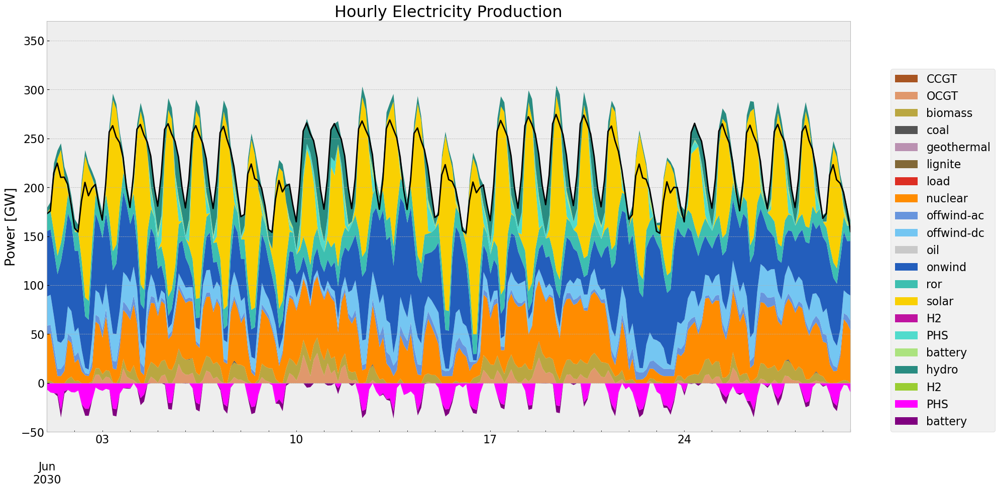

In [31]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [32]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

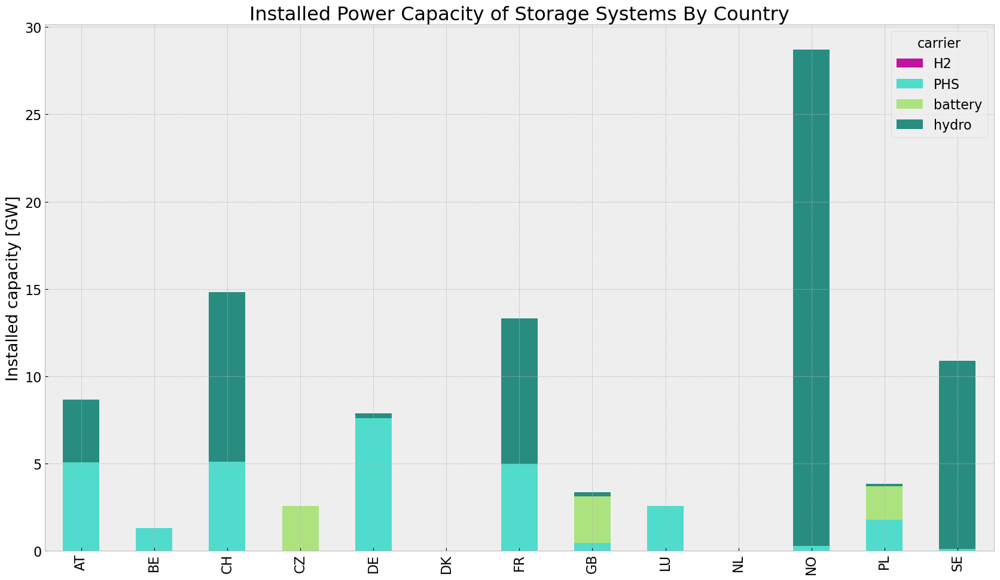

In [33]:
store_base = inst_store_table(n)

In [34]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='3H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')


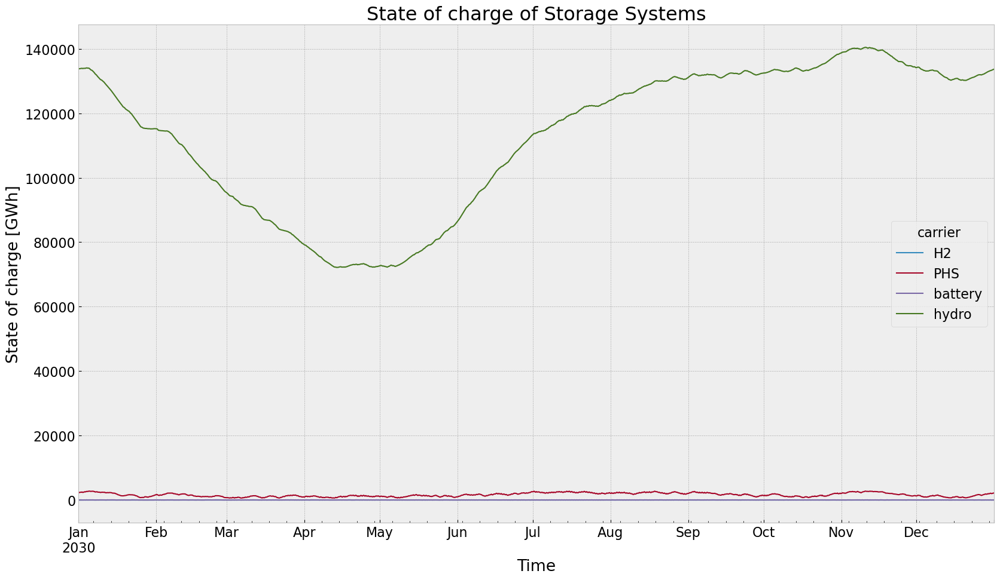

In [35]:
state_of_charge_plot(n,'2030-01-01 00:00','2030-12-31 21:00')

## Electricity Price

In [36]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [37]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


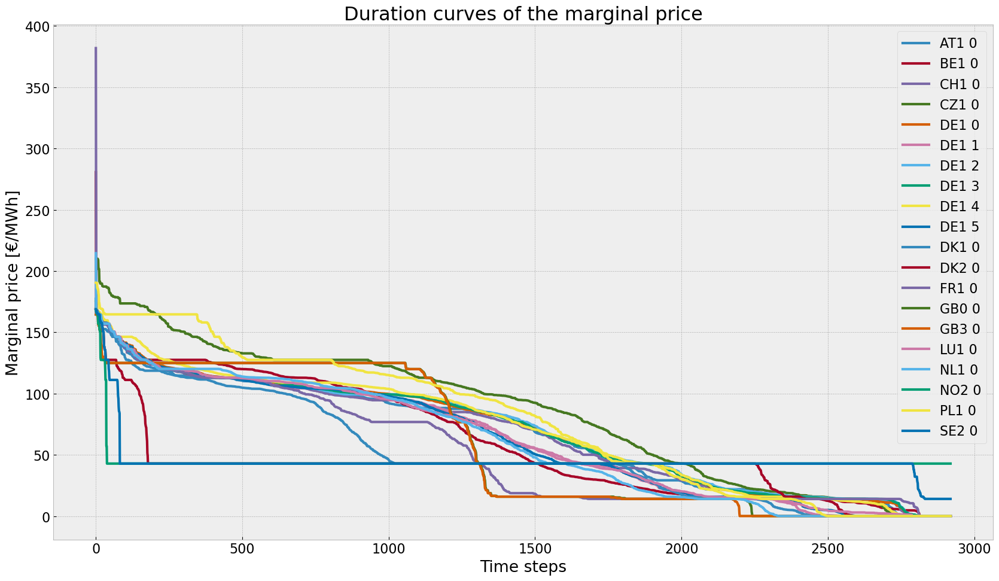

In [38]:
price_dur_curve_plot(n)

In [39]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


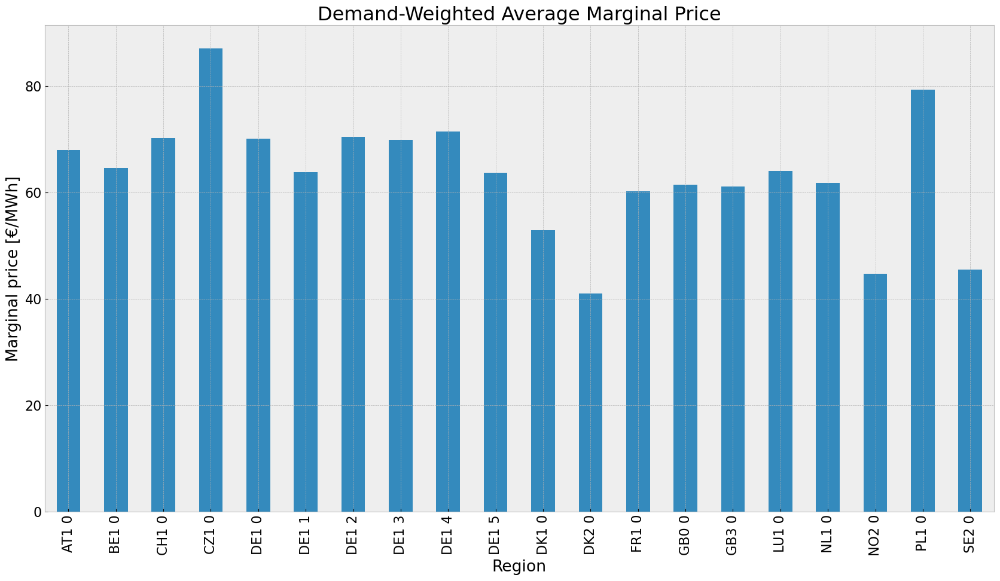

In [40]:
price_regions_table(n)

In [41]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


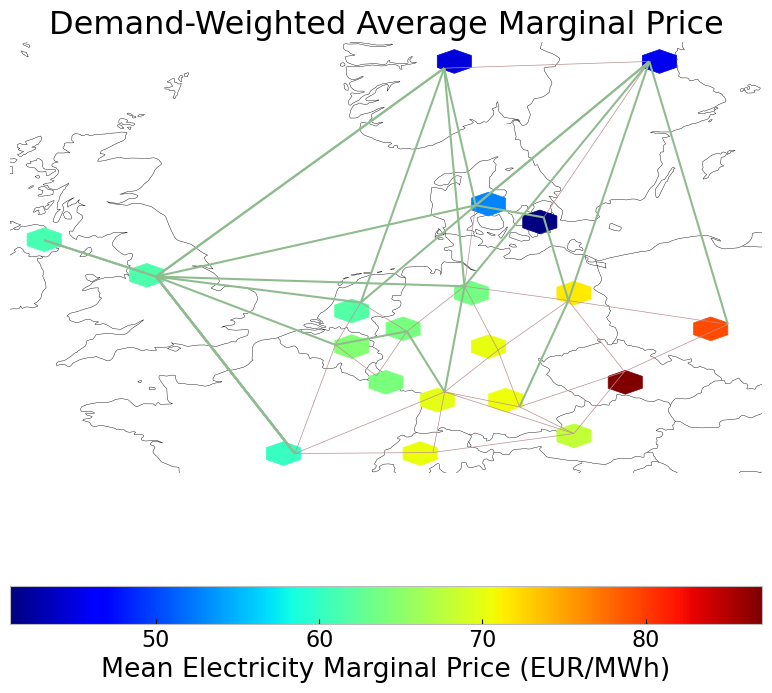

In [42]:
price_regions(n)

## Emission

In [43]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,4.314198e+07,0.451621,0.1980,1.891434e+07
biomass,3.094121e+07,0.468000,0.0000,0.000000e+00
coal,1.288390e+06,0.329908,0.3361,1.312572e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.347177e+06,0.337285,0.4069,1.625233e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.518514e+08,0.326600,0.0000,0.000000e+00
offwind-ac,2.084077e+07,1.000000,0.0000,0.000000e+00


# Wind Cut Scenario in all regions due to wind drought


In [44]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.5


def windscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement wind cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('offwind-ac') or column.endswith('offwind-dc') or column.endswith('onwind'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto 
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = windscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}'          

## 1. Model: perfect foresight with allowed additional investment

### Allow investment

In [45]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [46]:
#n1.optimize(solver_name= "gurobi")
filename = f'inv_{contingency}.nc'
n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

INFO:pypsa.io:Imported network inv_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export model for later use

In [47]:
#file = f"{n1.name}.nc"
#output_path = os.path.join(os.getcwd(), file)
#n1.export_to_netcdf(output_path)

In [48]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

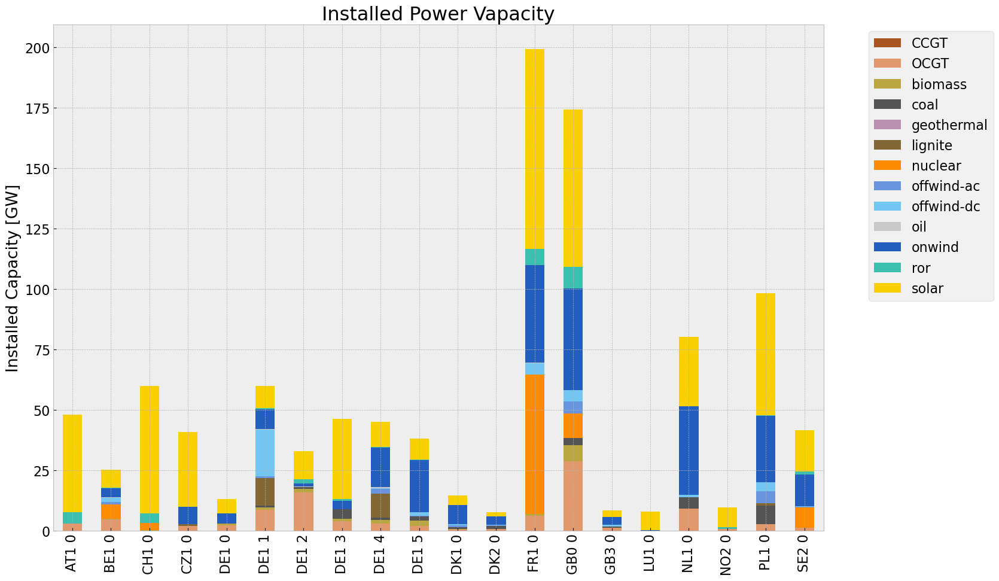

<Figure size 640x480 with 0 Axes>

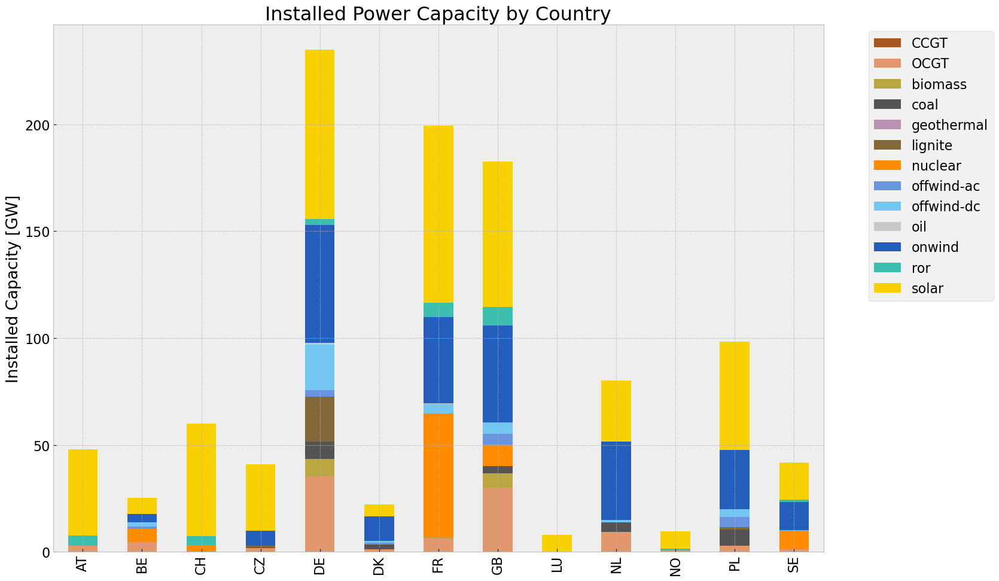

In [49]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

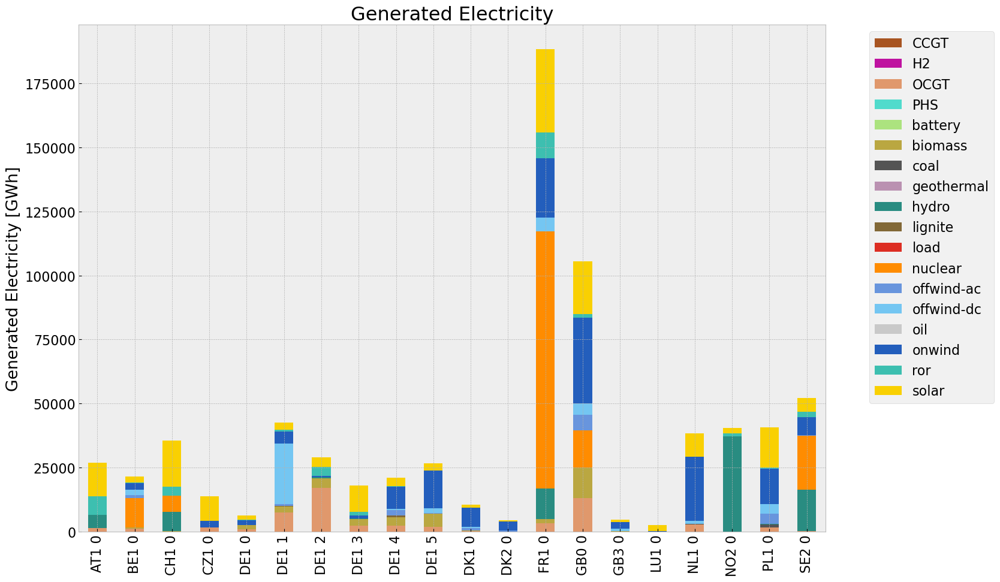

<Figure size 640x480 with 0 Axes>

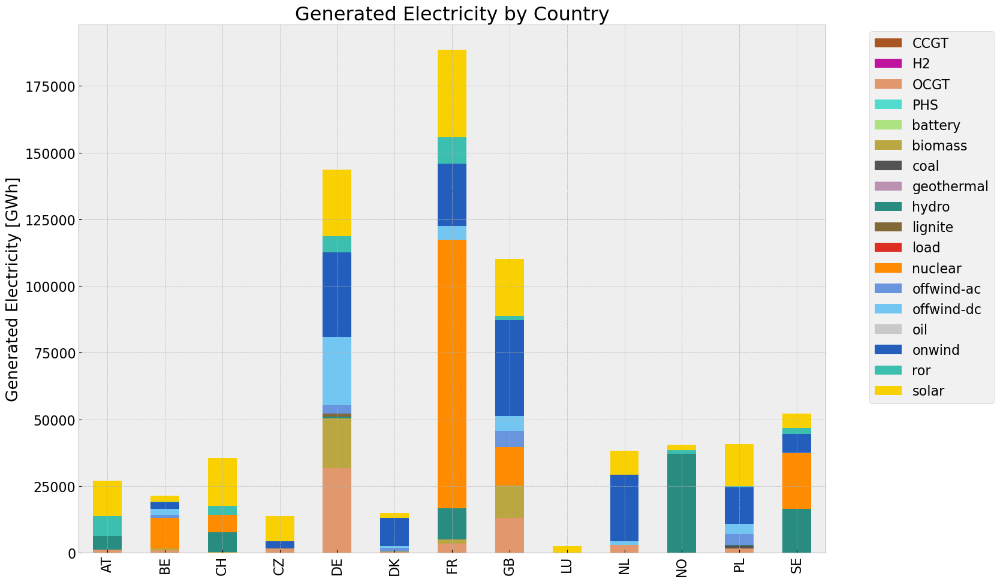

In [50]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

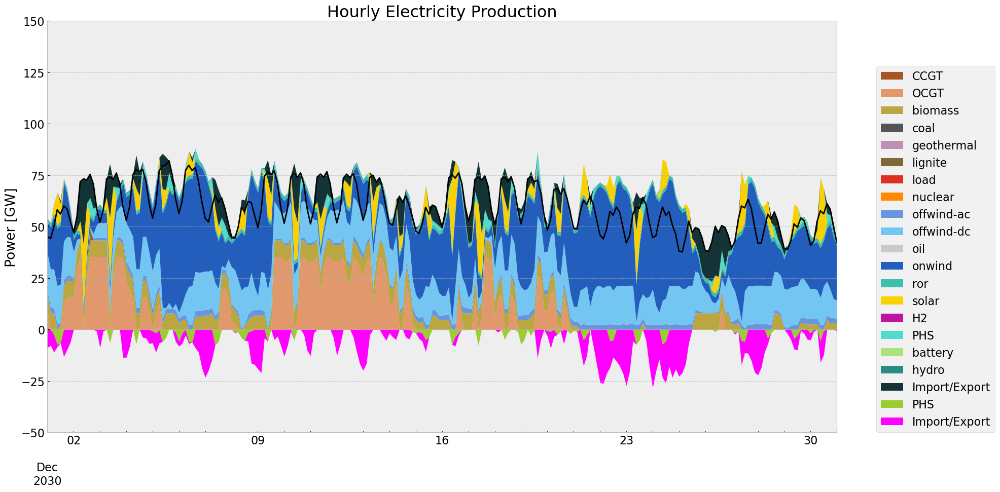

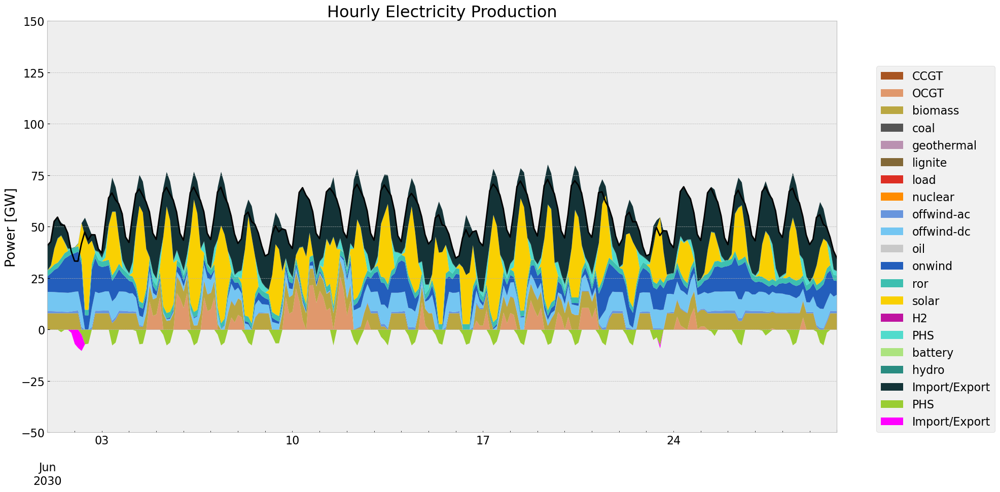

In [51]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

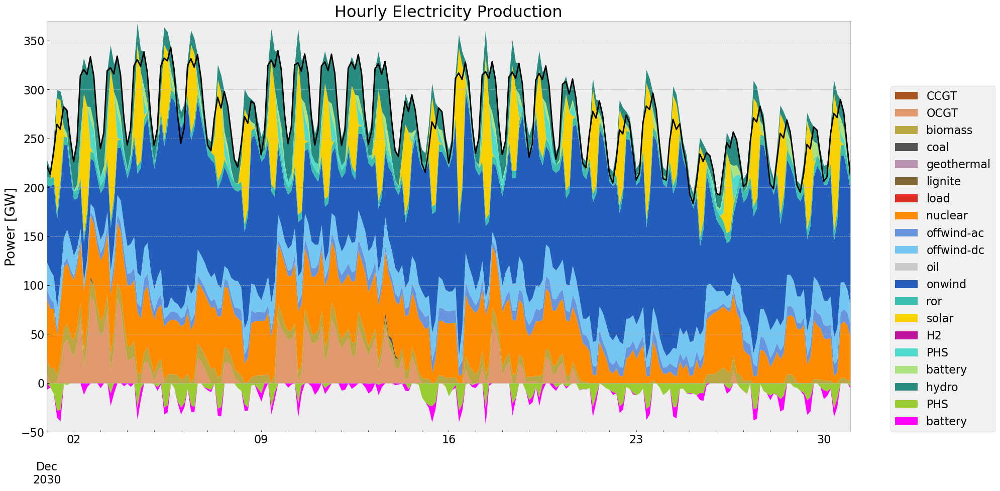

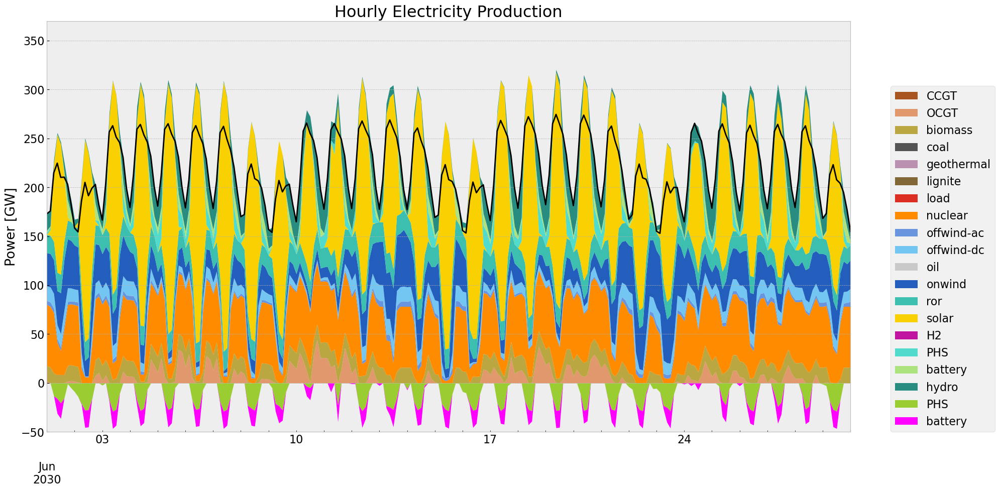

In [52]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

### Storage

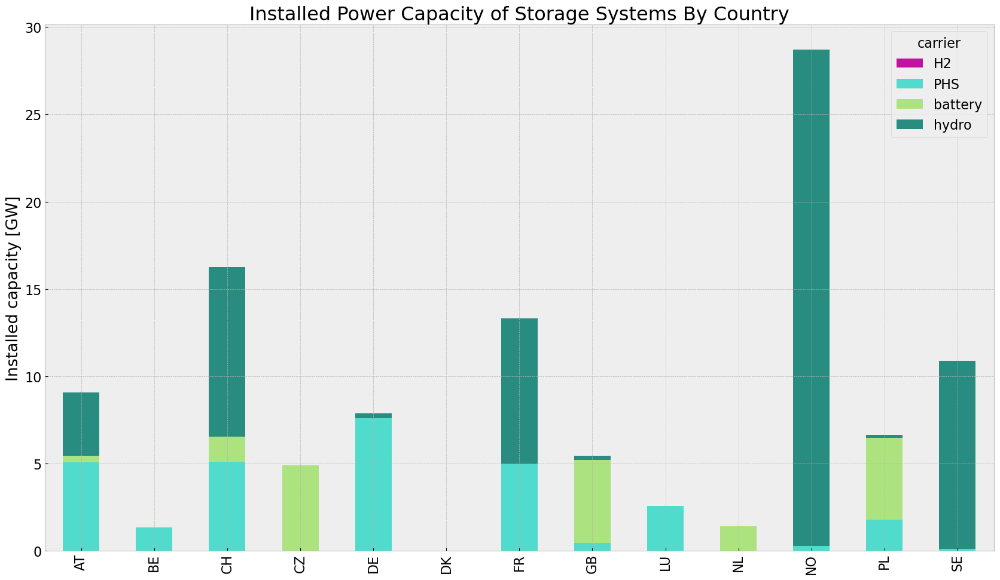

In [53]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')


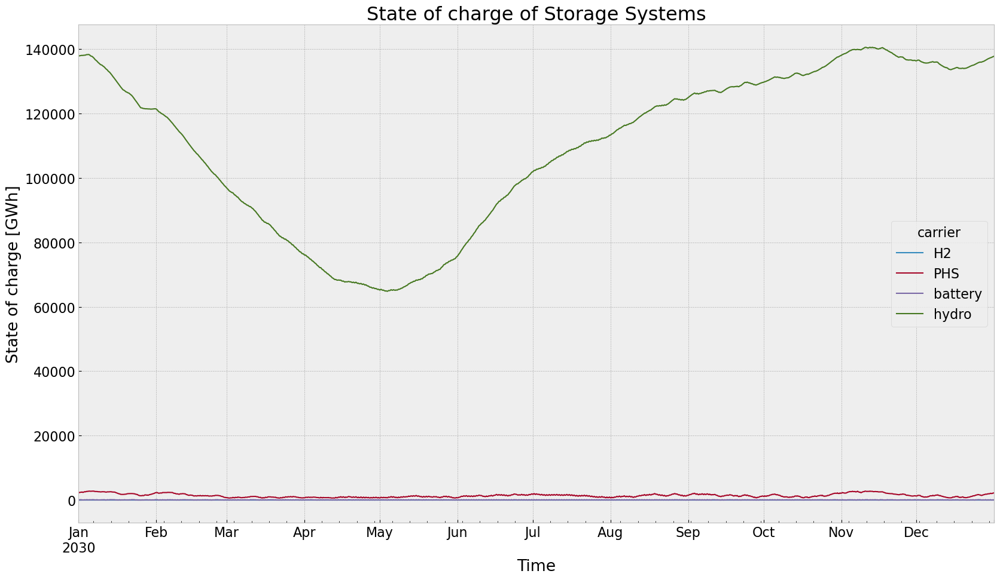

In [54]:
state_of_charge_plot(n1,'2030-01-01 00:00','2030-12-31 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


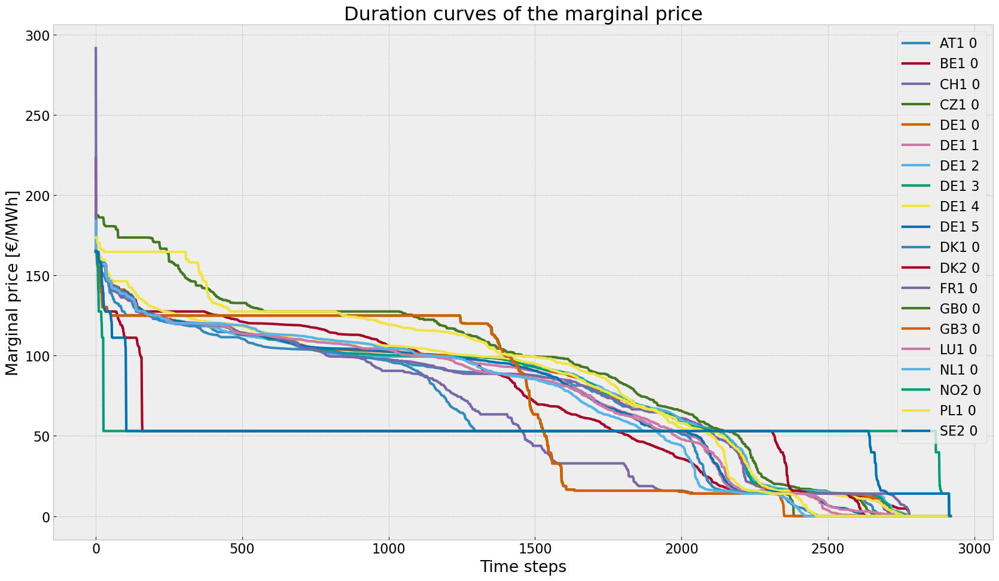

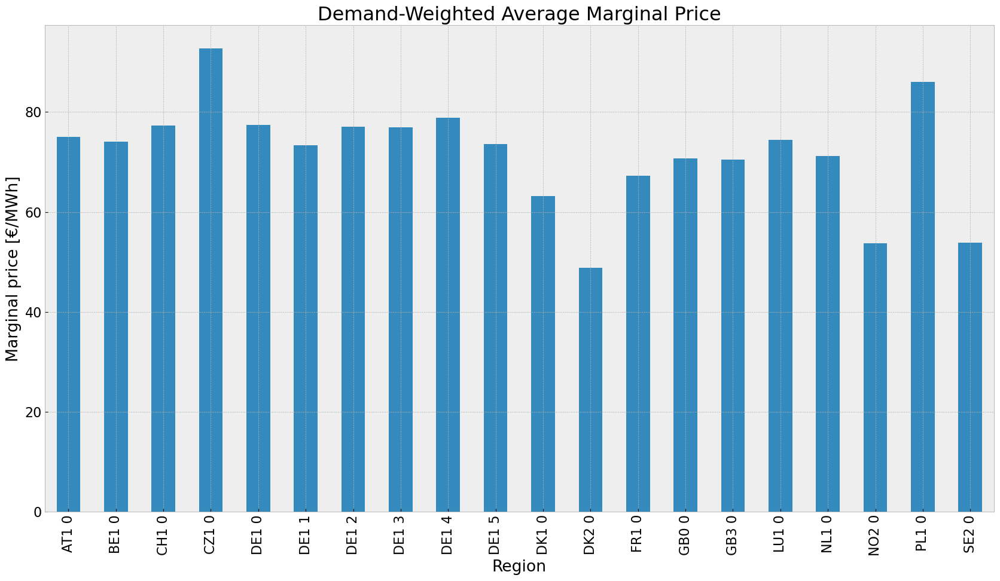

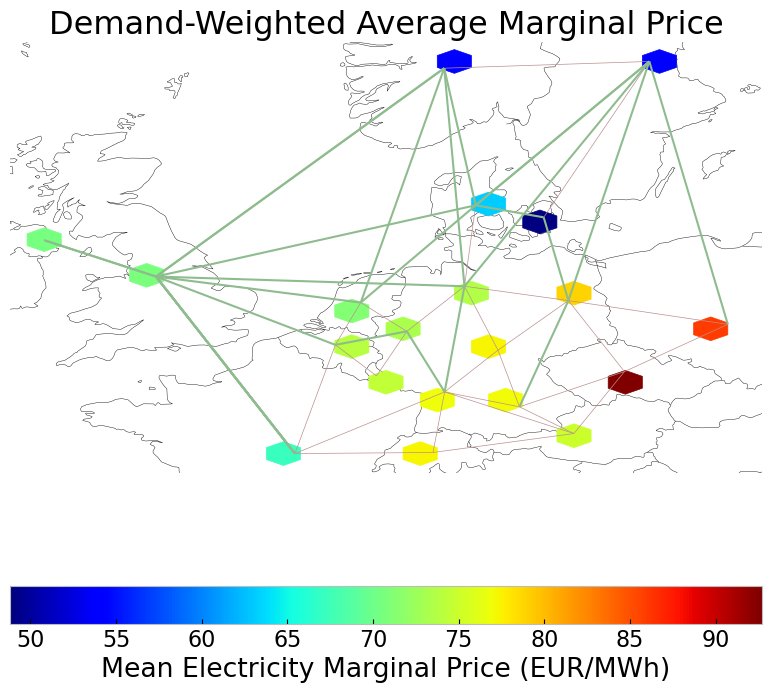

In [55]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [56]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,5.680067e+07,0.451621,0.1980,2.490260e+07
biomass,3.340009e+07,0.468000,0.0000,0.000000e+00
coal,1.005179e+06,0.329908,0.3361,1.024045e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.128401e+06,0.337285,0.4069,1.361302e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.537621e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.586395e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [57]:
n2 = windscenario(n, cut_start, duration, reductionto)

### No Investment

In [58]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [59]:
#n2.optimize(solver_name ='gurobi')
filename = f"noinv_{contingency}.nc"
n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:pypsa.io:Imported network noinv_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export model for later use

In [60]:
#file = f"{n2.name}.nc"
#output_path = os.path.join(os.getcwd(), file)
#n2.export_to_netcdf(output_path)

In [61]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

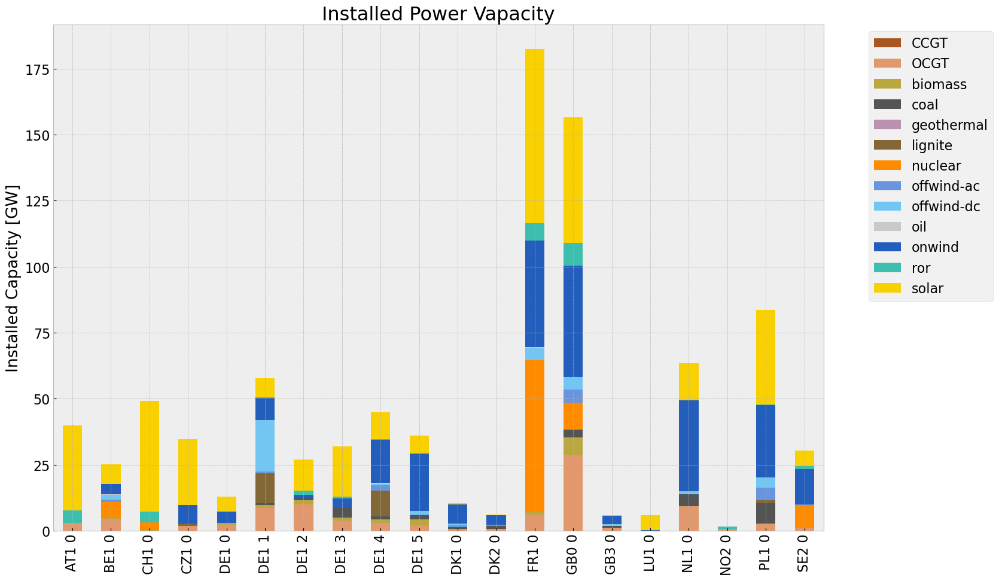

<Figure size 640x480 with 0 Axes>

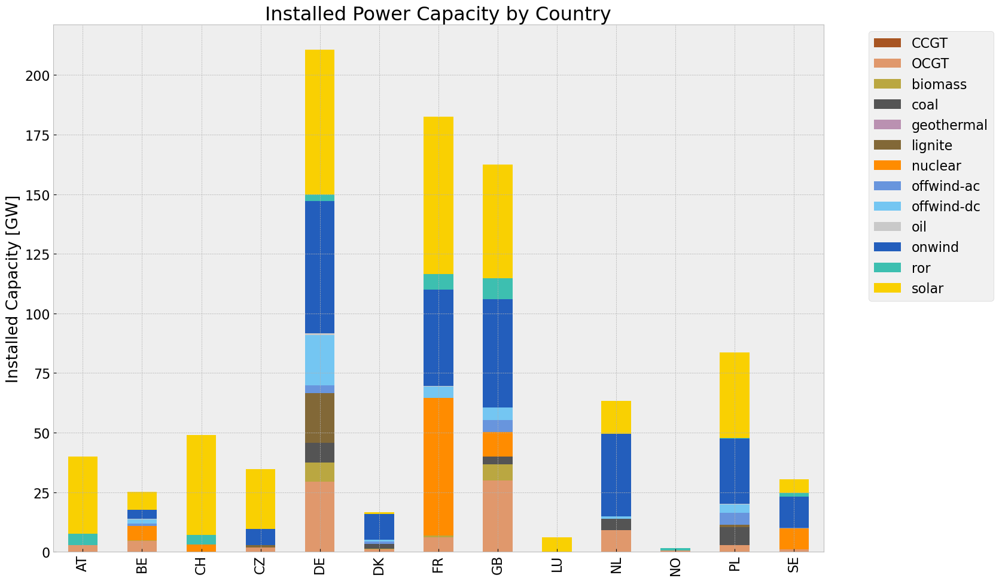

In [62]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

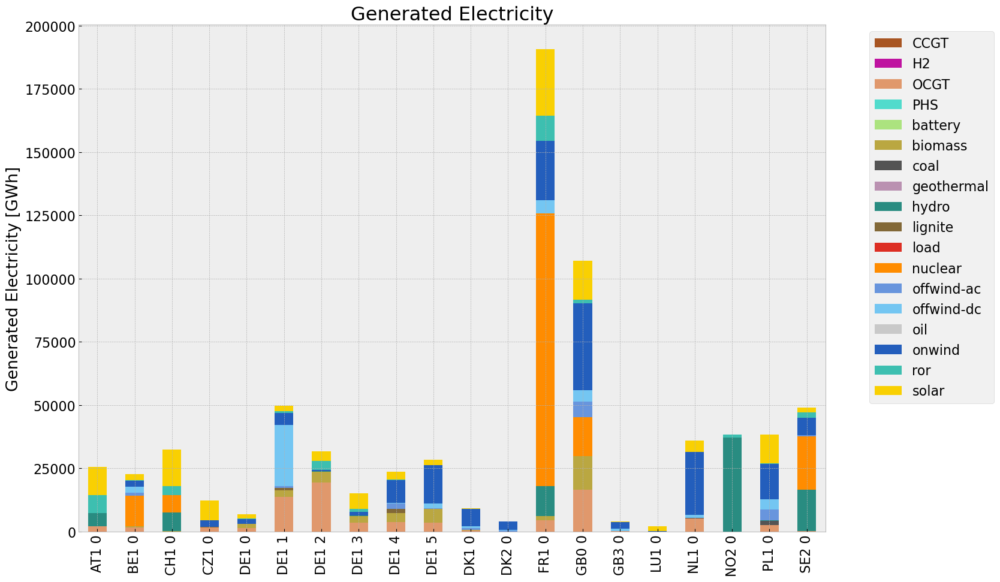

<Figure size 640x480 with 0 Axes>

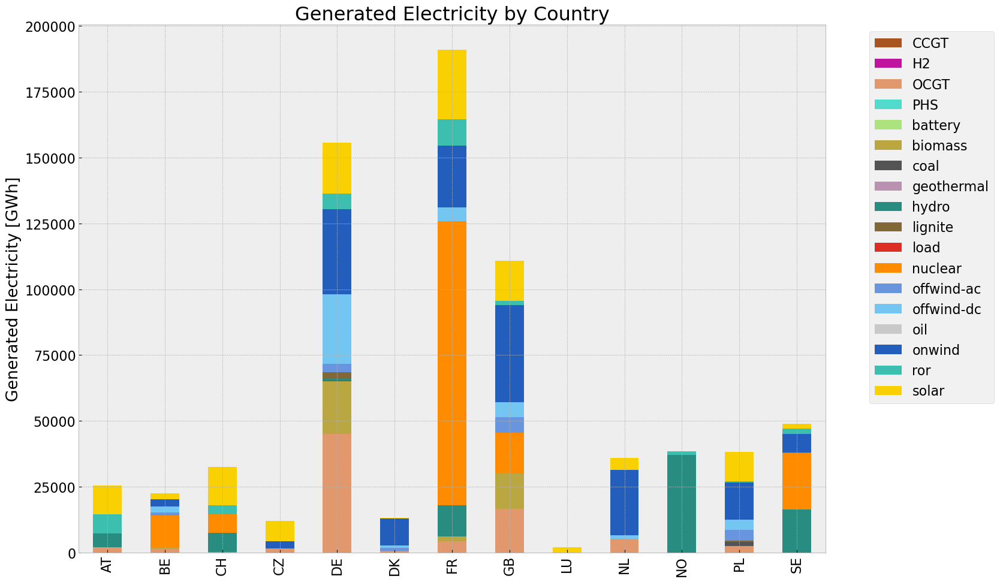

In [63]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

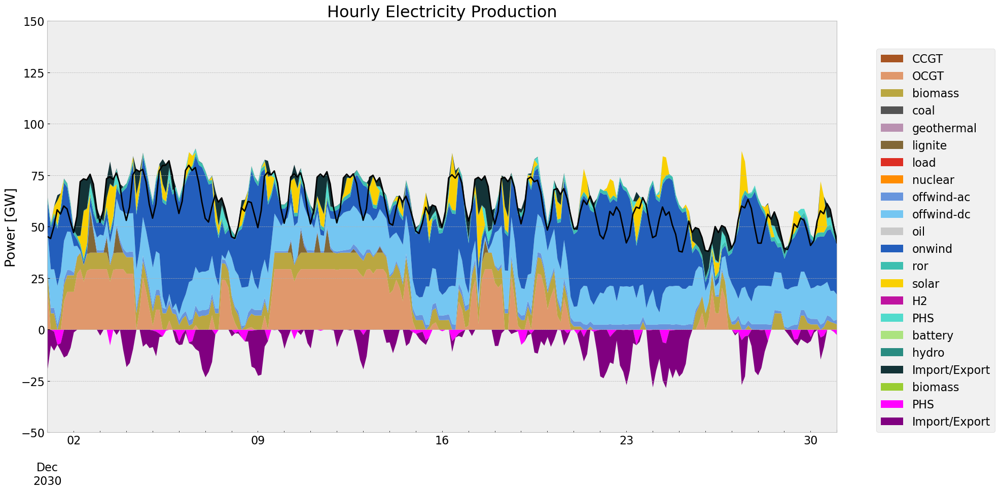

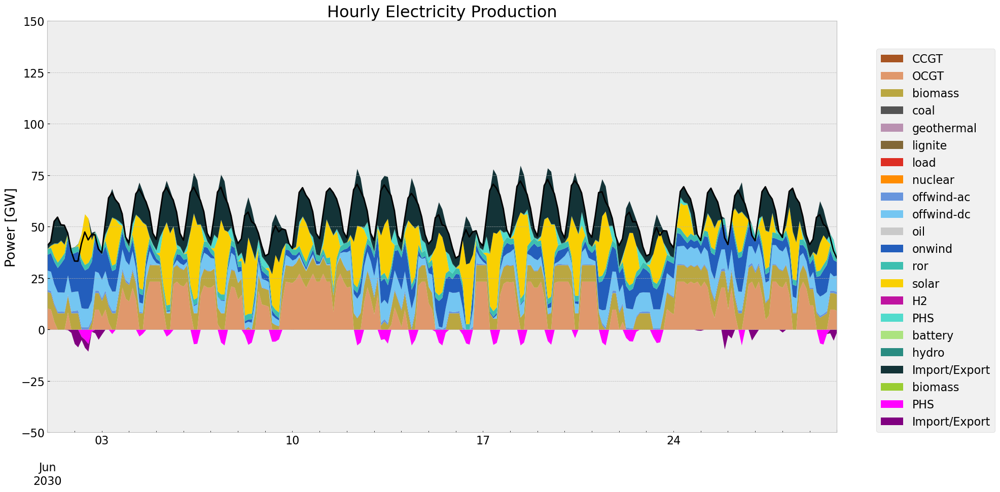

In [64]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

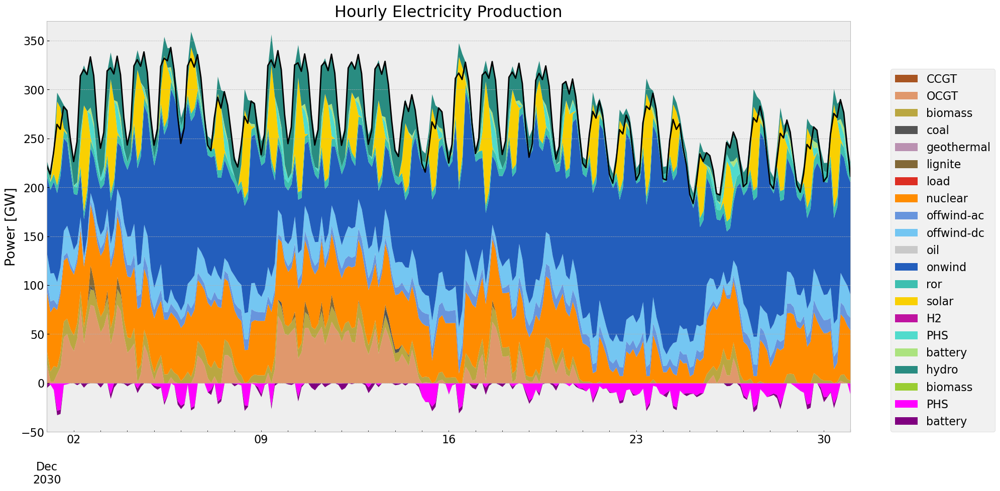

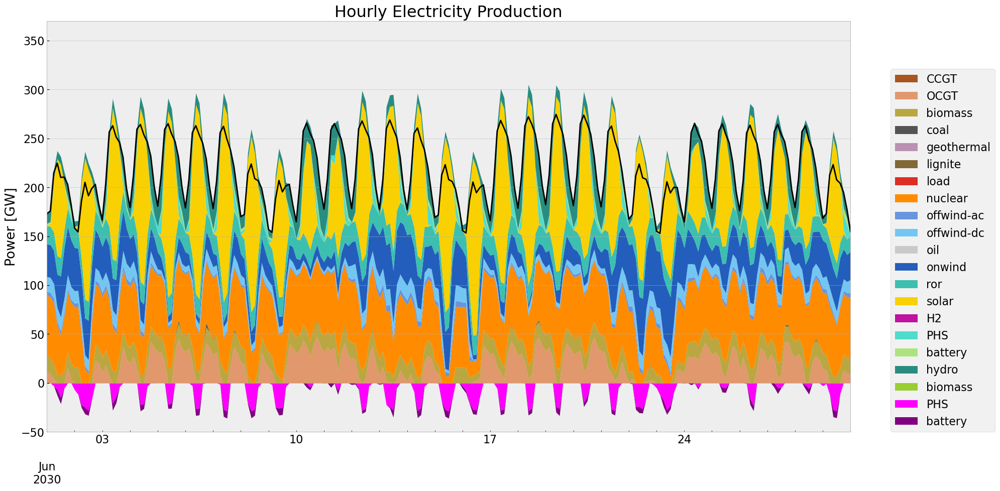

In [65]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

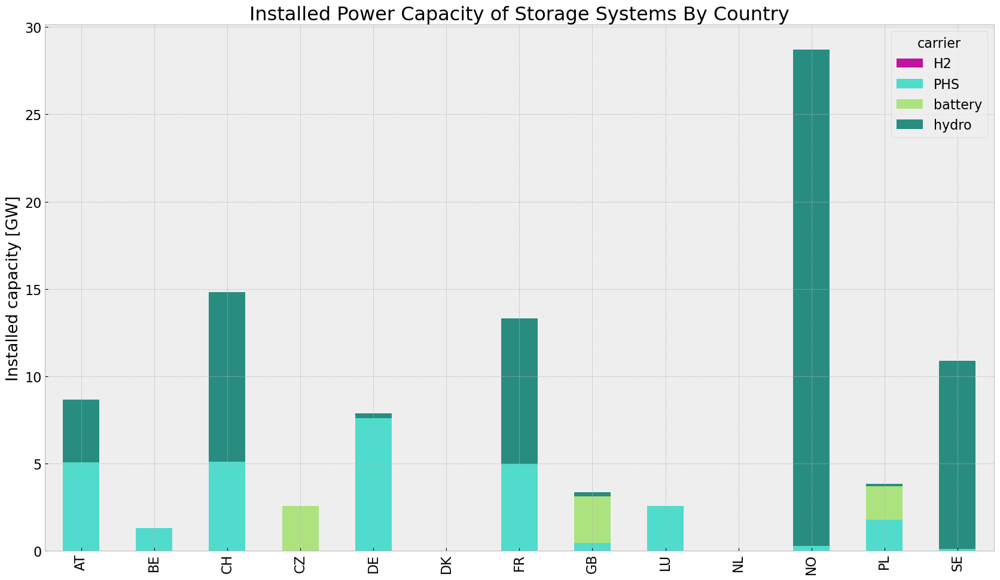

In [66]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440348564.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\773107986.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.974360e+07,0.451621,0.1980,3.496126e+07
biomass,3.632033e+07,0.468000,0.0000,0.000000e+00
coal,1.826018e+06,0.329908,0.3361,1.860291e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,2.610041e+06,0.337285,0.4069,3.148751e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.633916e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.619694e+07,1.000000,0.0000,0.000000e+00


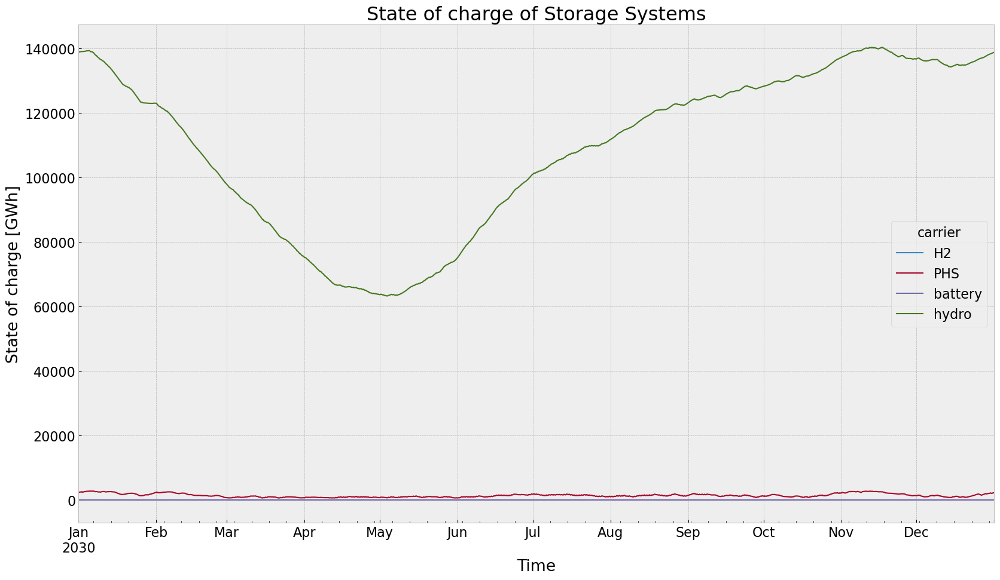

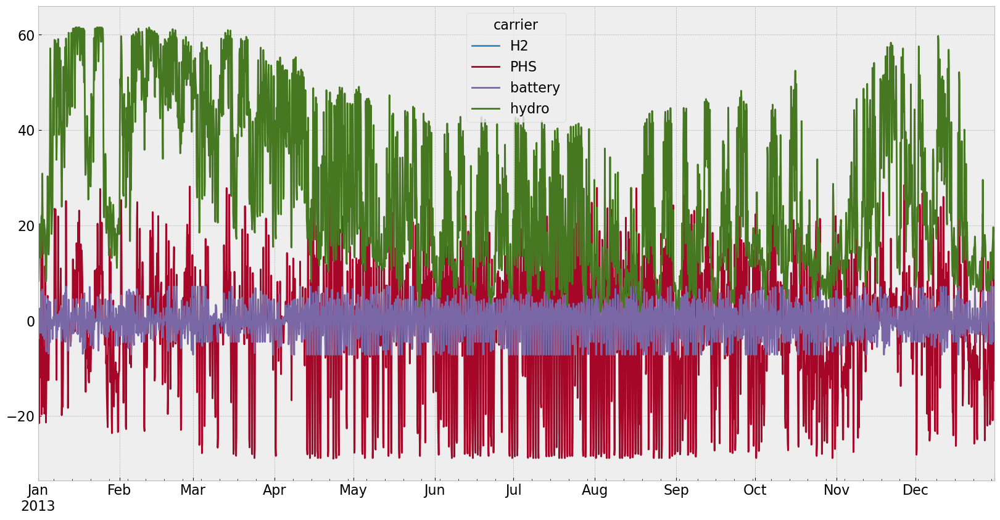

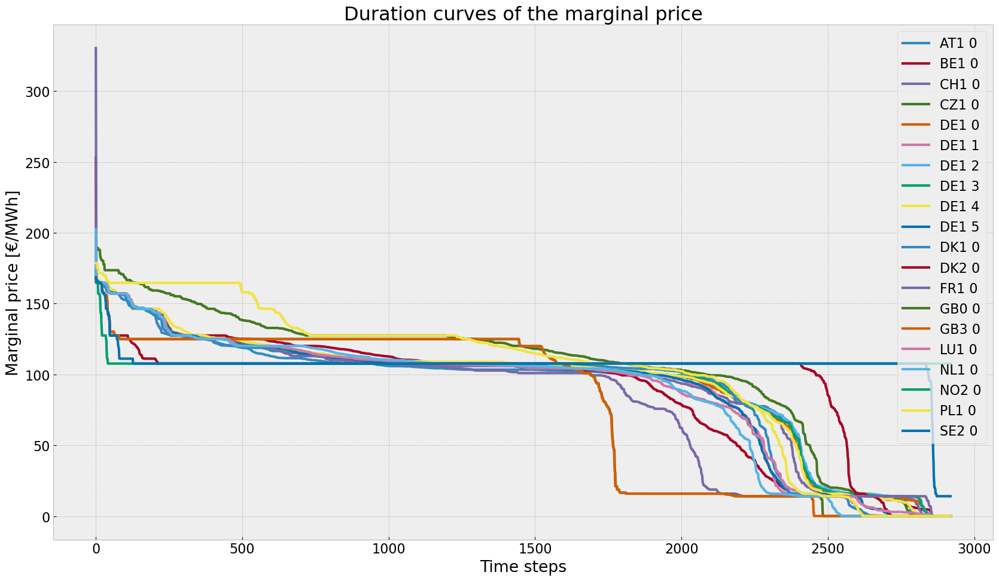

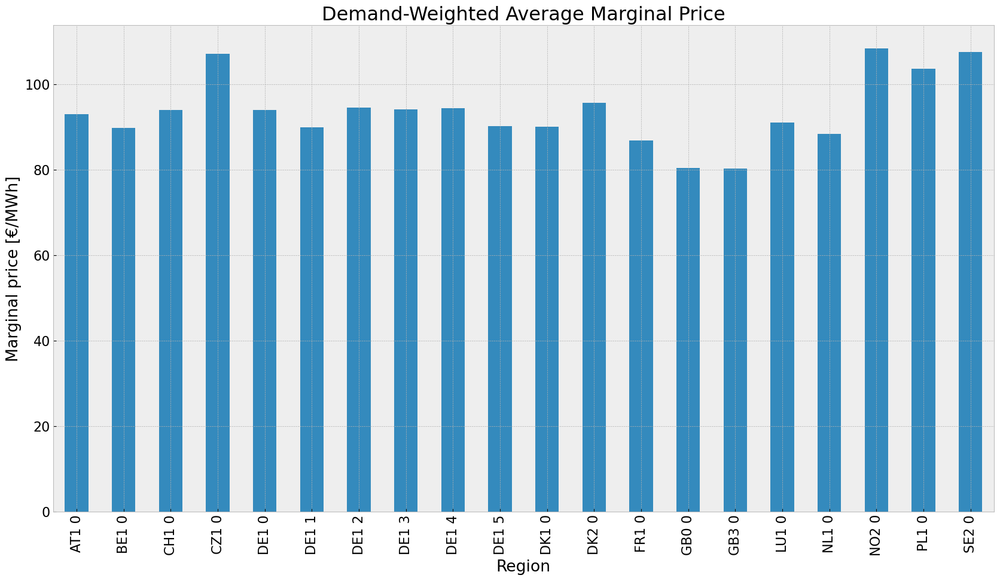

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


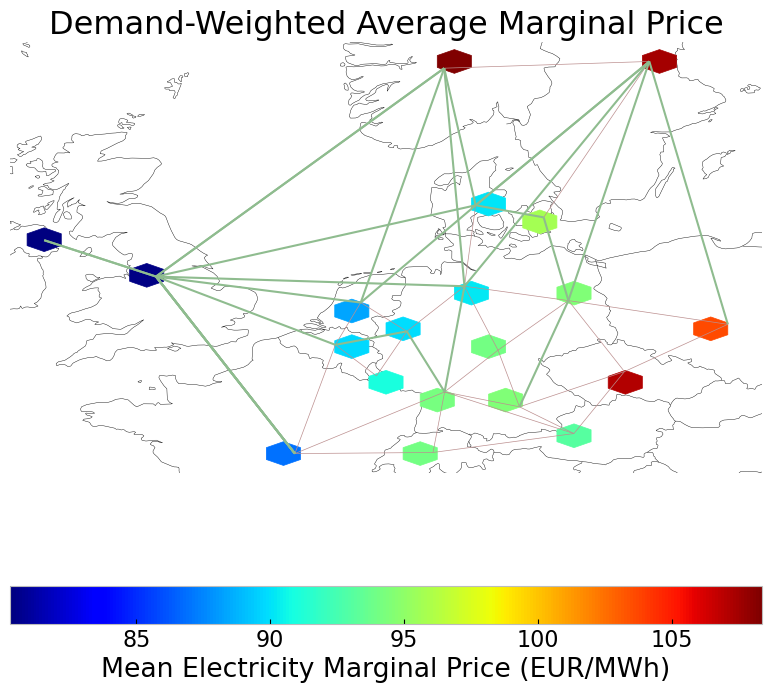

In [67]:
#state of charge
state_of_charge_plot(n2,'2030-01-01 00:00','2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [68]:
n3= n2.copy()

horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


#optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
filename = f"noinv_roll_{contingency}.nc"
n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.io:Imported network noinv_roll_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export Model for later use

In [69]:
#filename = f"{n3.name}.nc"
#output_path = os.path.join(os.getcwd(), filename)
#n3.export_to_netcdf(output_path)

In [70]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

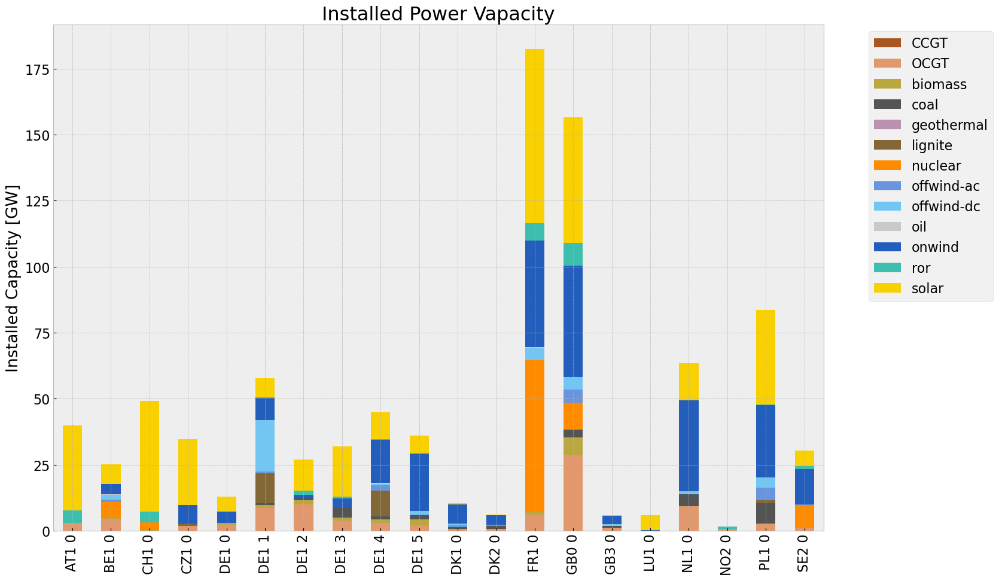

<Figure size 640x480 with 0 Axes>

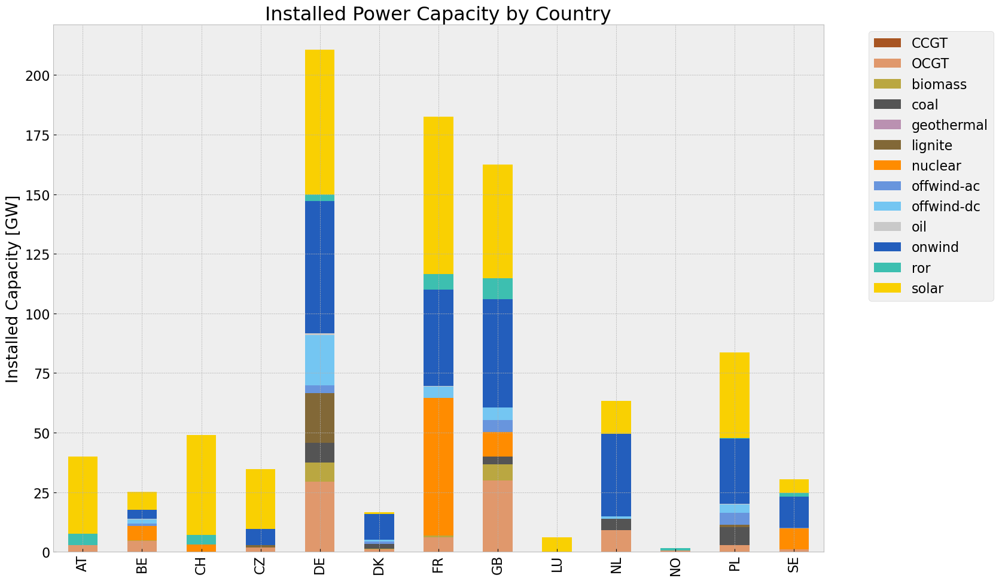

<Figure size 640x480 with 0 Axes>

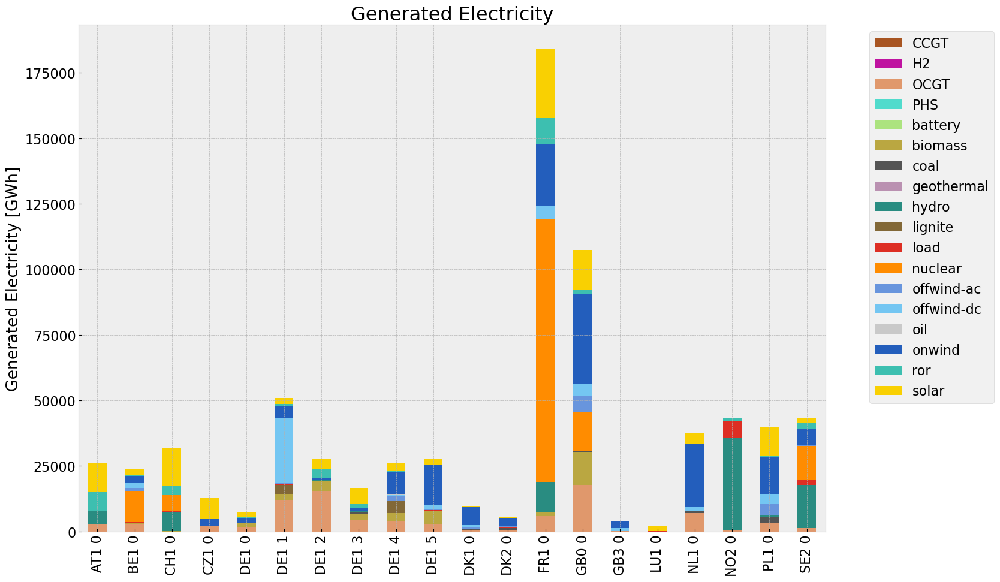

<Figure size 640x480 with 0 Axes>

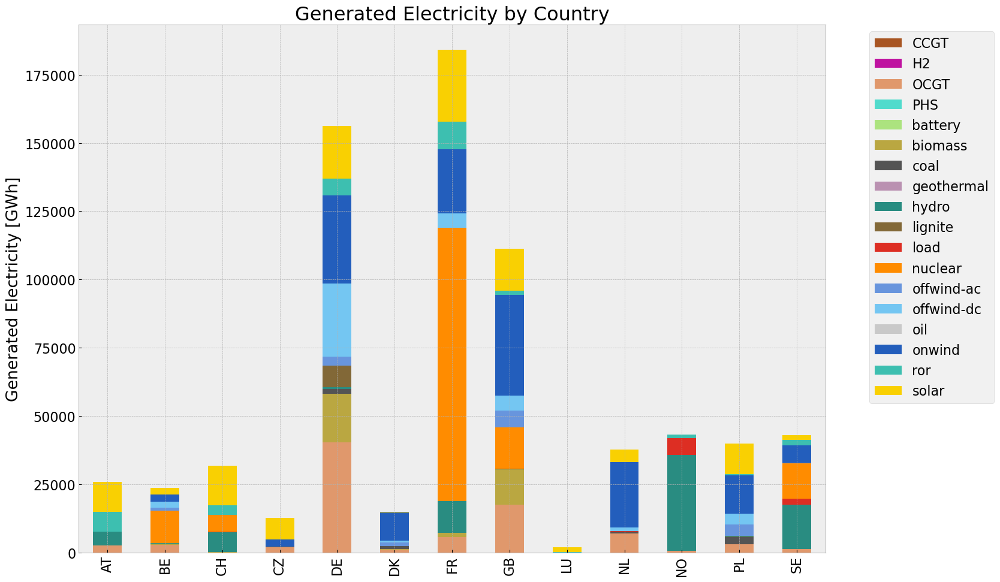

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.464603e+07,0.451621,0.1980,3.711059e+07
biomass,3.319611e+07,0.468000,0.0000,0.000000e+00
coal,6.132877e+06,0.329908,0.3361,6.247983e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.108687e+06,0.337285,0.4069,9.782312e+06
load,9.015338e+06,1.000000,0.0000,0.000000e+00
nuclear,1.460571e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.613912e+07,1.000000,0.0000,0.000000e+00


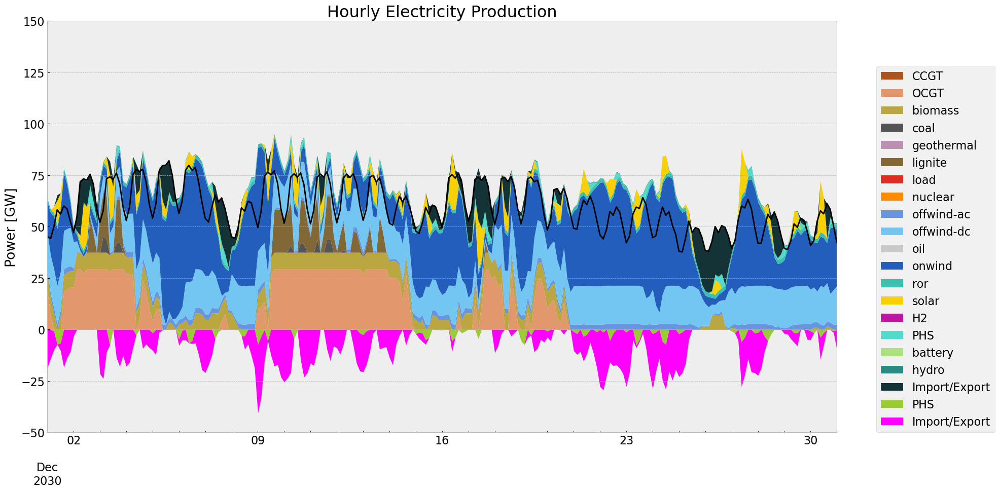

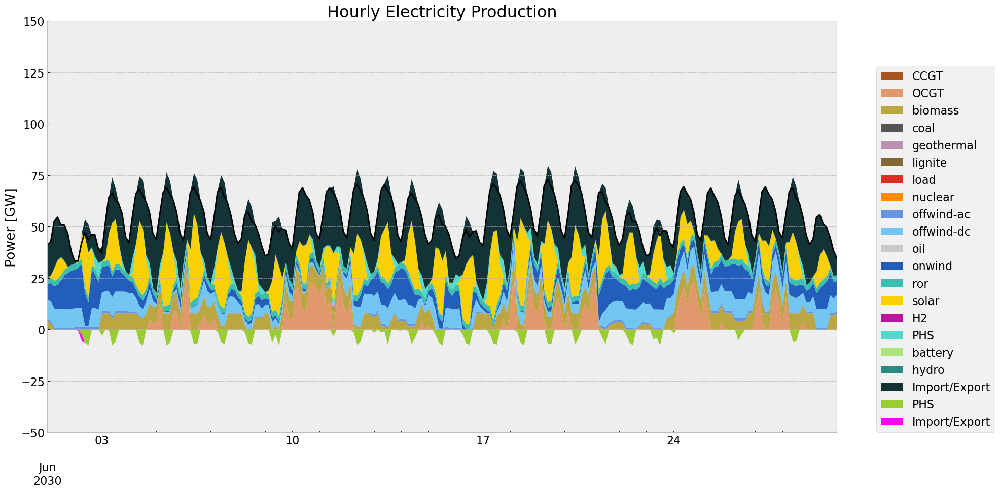

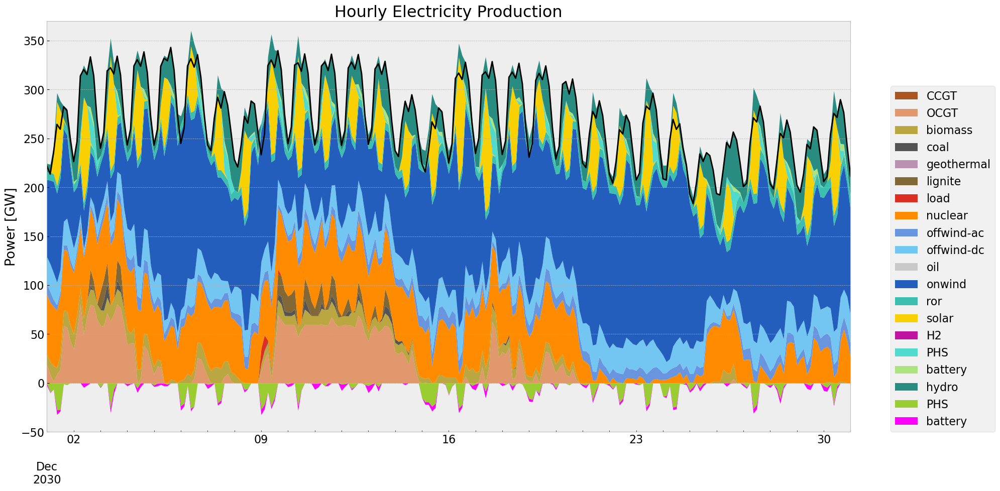

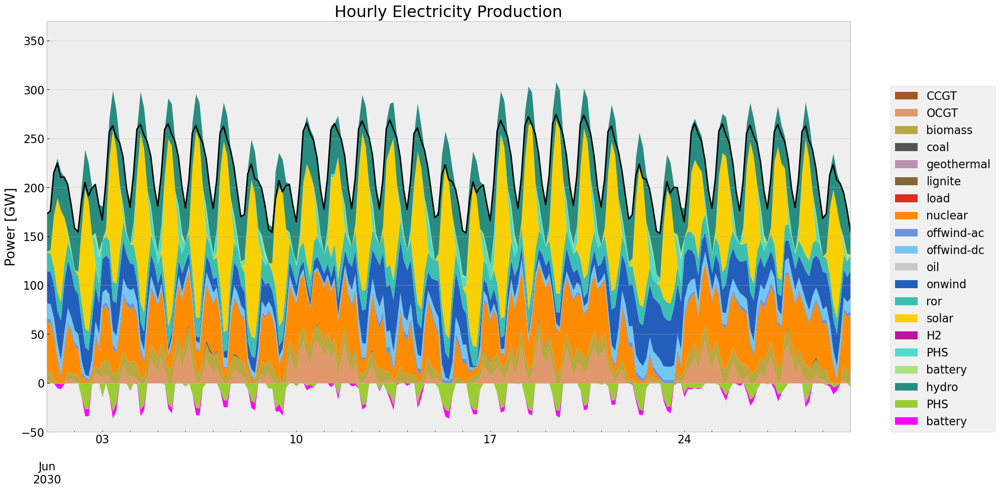

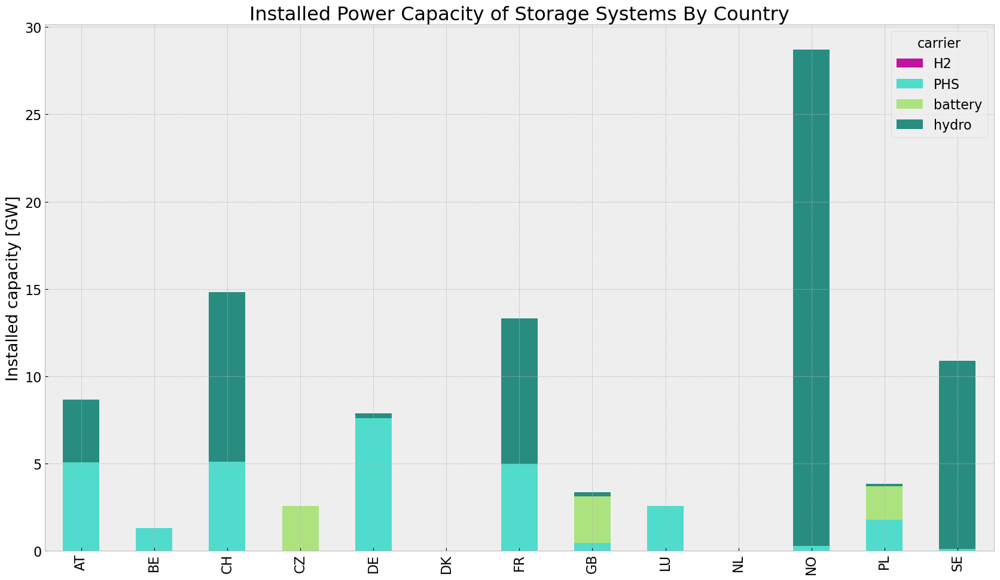

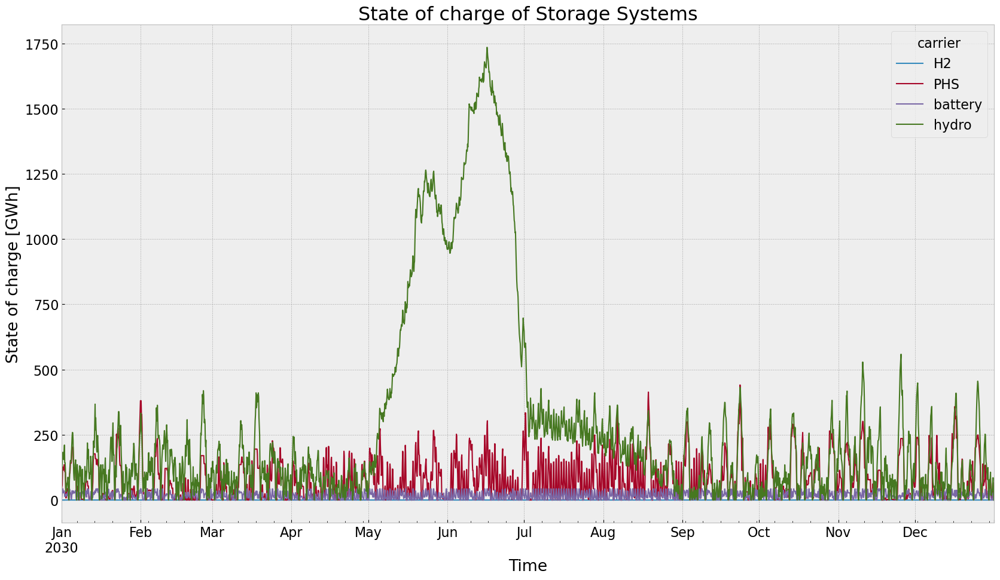

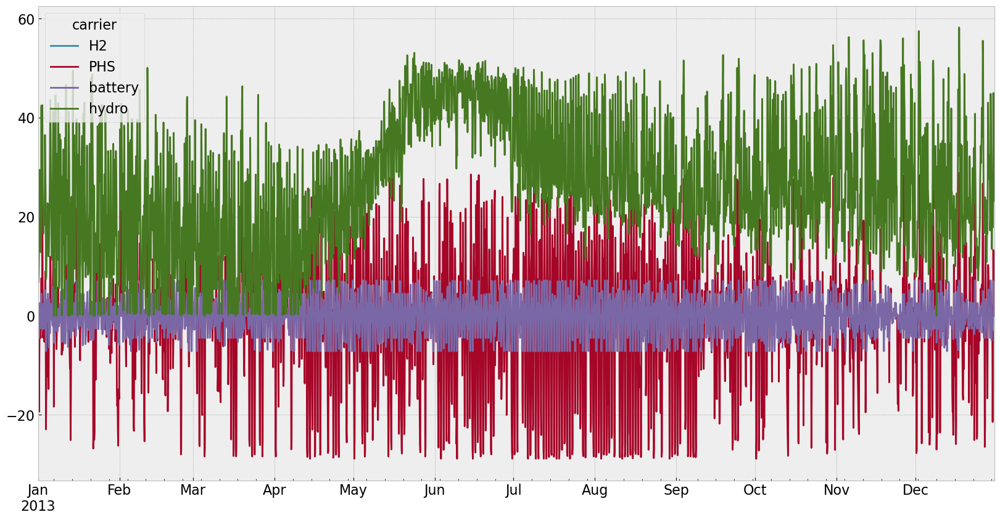

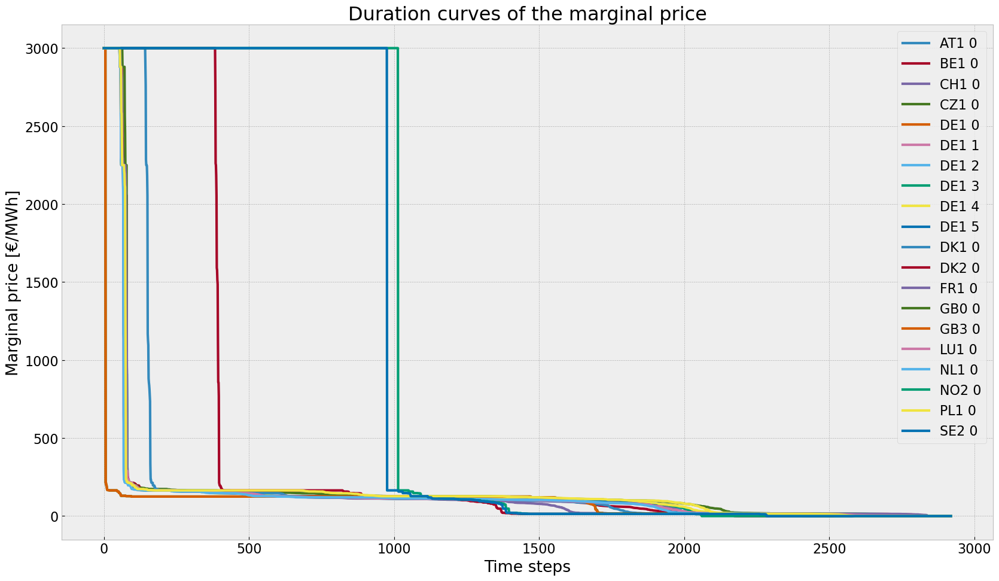

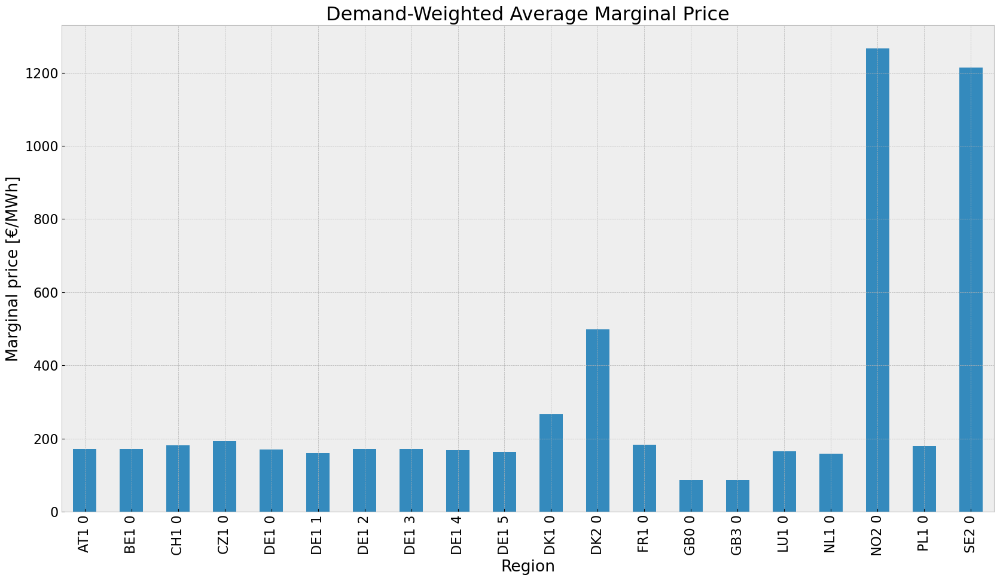

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


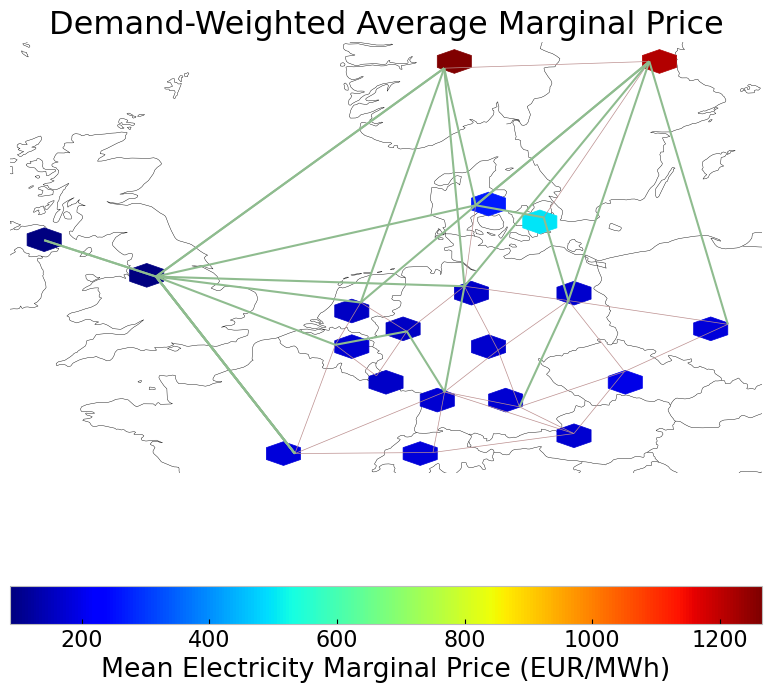

In [71]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3,'2030-01-01 00:00','2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [72]:
n4 = n1.copy()

horizon = 24

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


#optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
filename = f"inv_roll_{contingency}.nc"
n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.io:Imported network inv_roll_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Export Model for later use

In [73]:
#filename = f"{n4.name}.nc"
#output_path = os.path.join(os.getcwd(), filename)
#n4.export_to_netcdf(output_path)

In [74]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

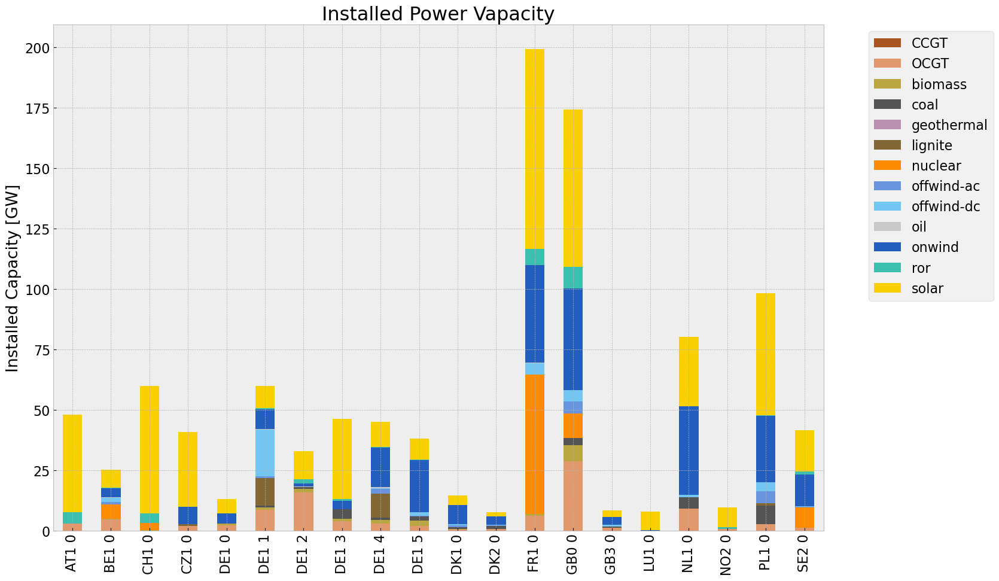

<Figure size 640x480 with 0 Axes>

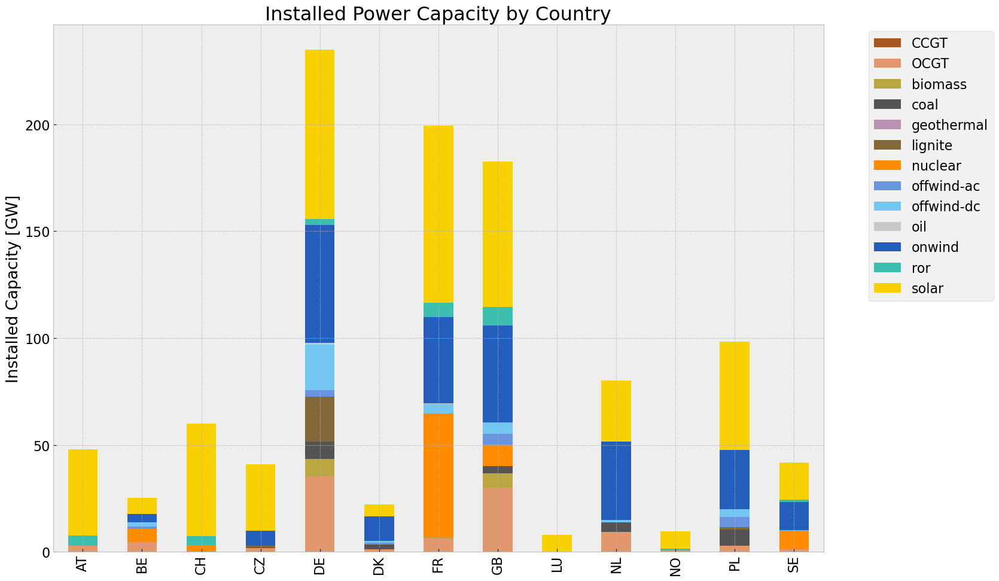

<Figure size 640x480 with 0 Axes>

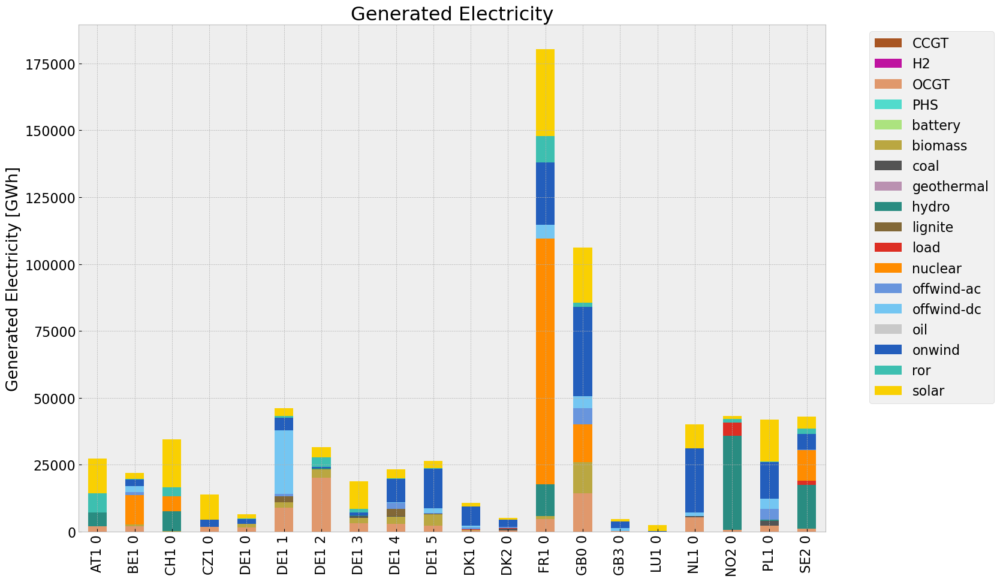

<Figure size 640x480 with 0 Axes>

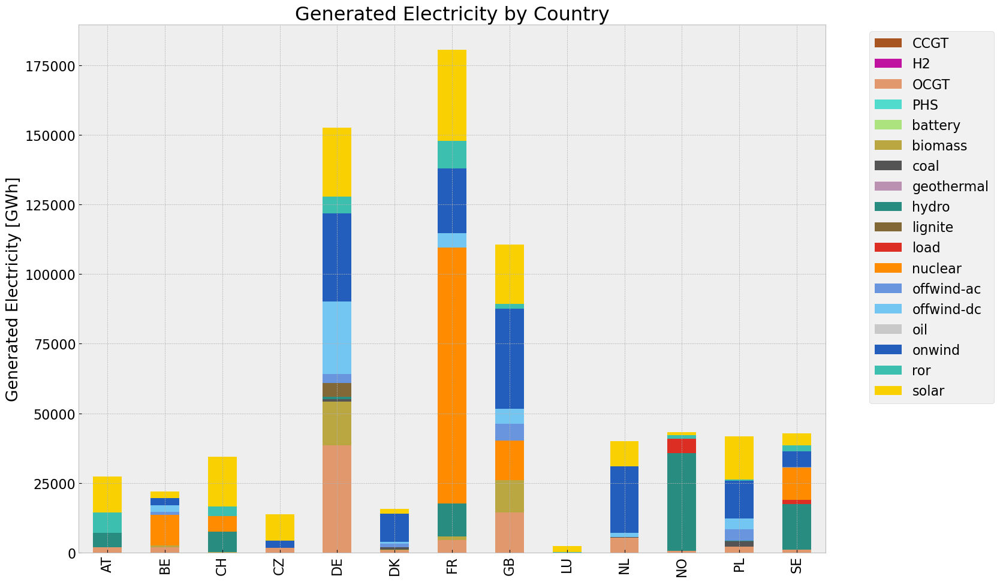

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.348839e+07,0.451621,0.1980,3.221885e+07
biomass,2.958710e+07,0.468000,0.0000,0.000000e+00
coal,3.860080e+06,0.329908,0.3361,3.932529e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,5.229767e+06,0.337285,0.4069,6.309186e+06
load,6.884390e+06,1.000000,0.0000,0.000000e+00
nuclear,1.339942e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.572306e+07,1.000000,0.0000,0.000000e+00


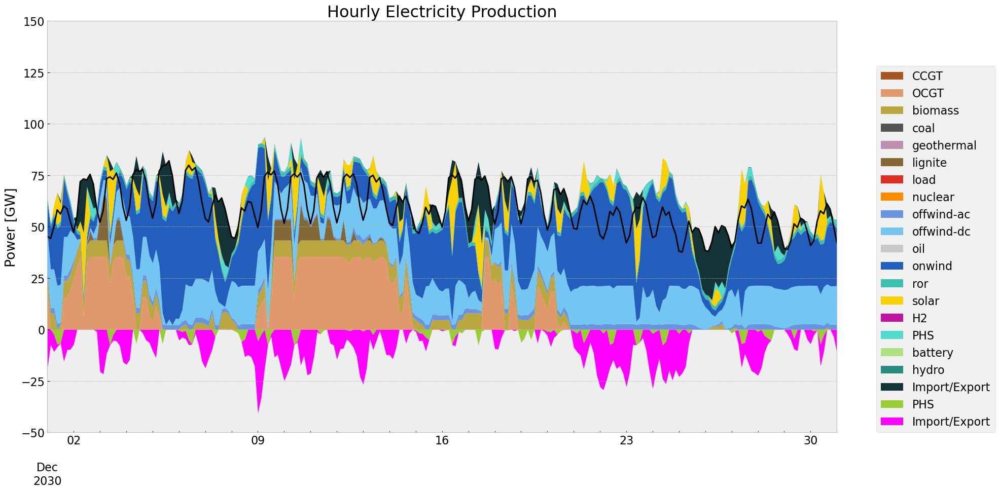

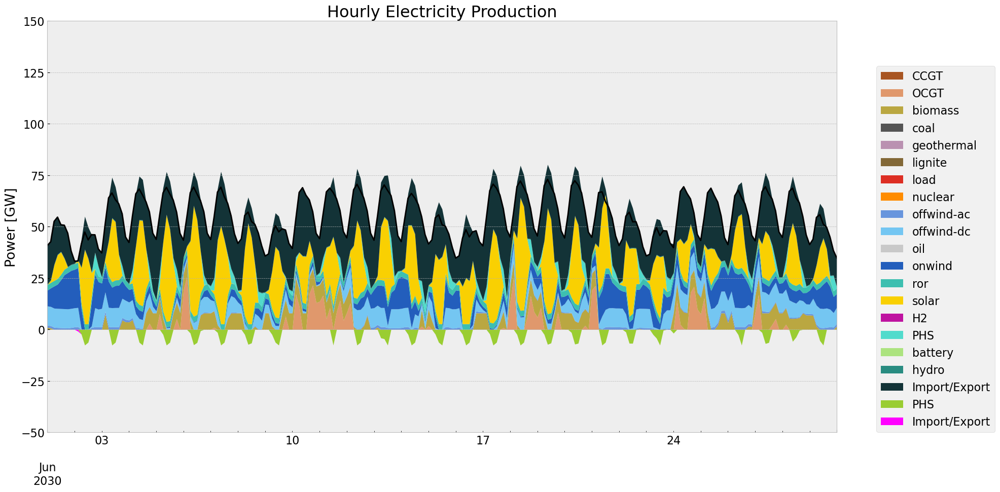

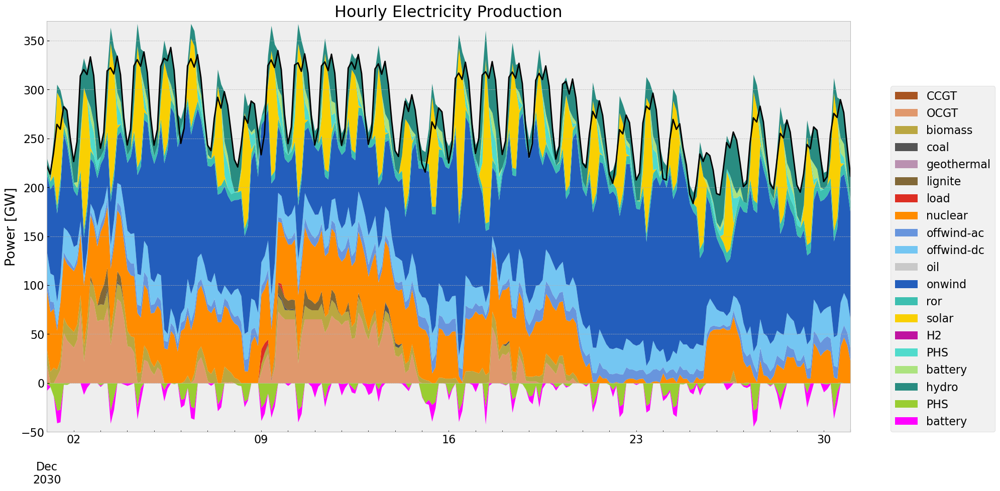

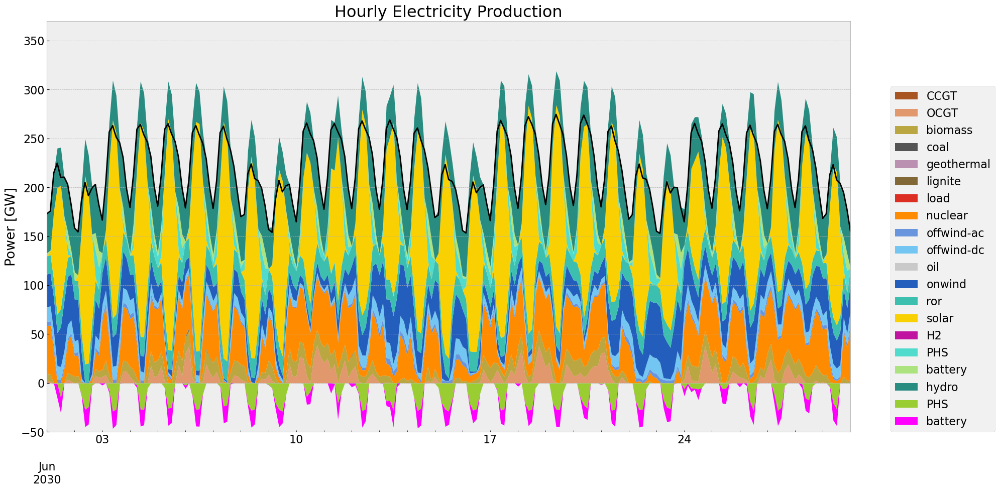

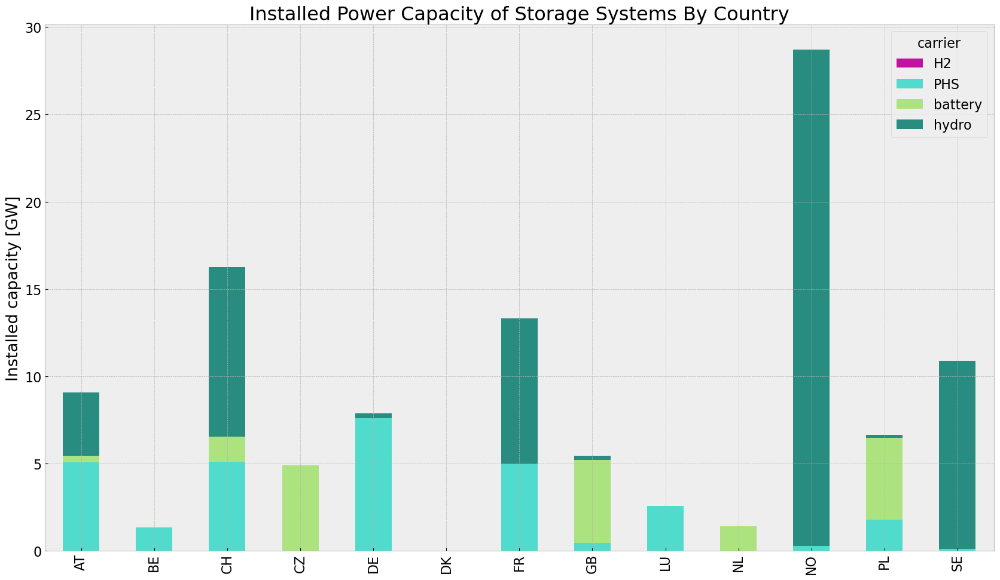

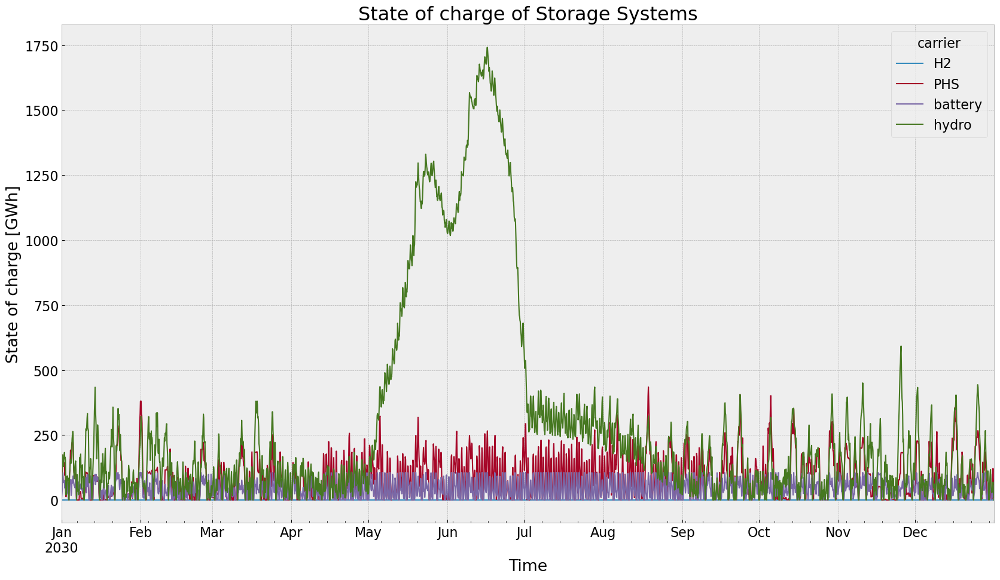

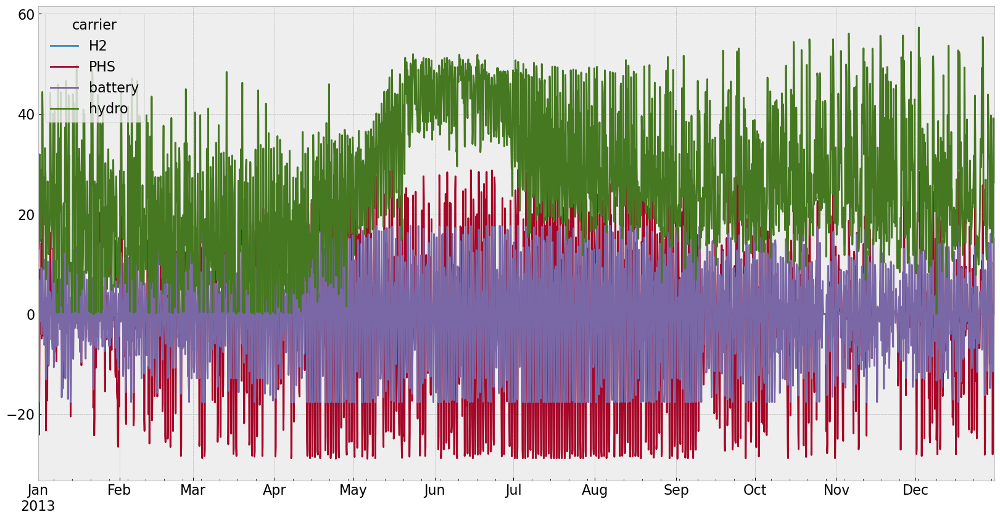

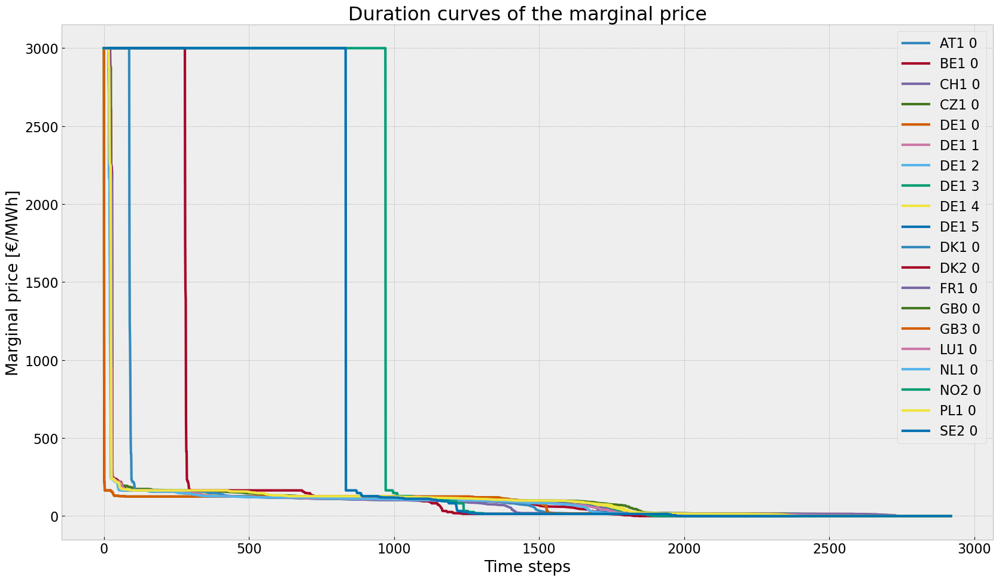

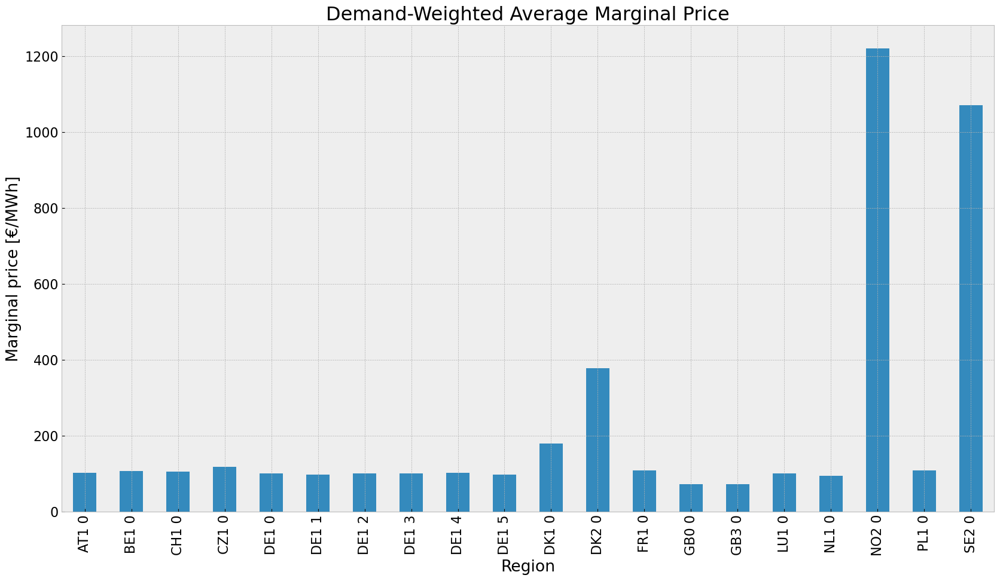

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


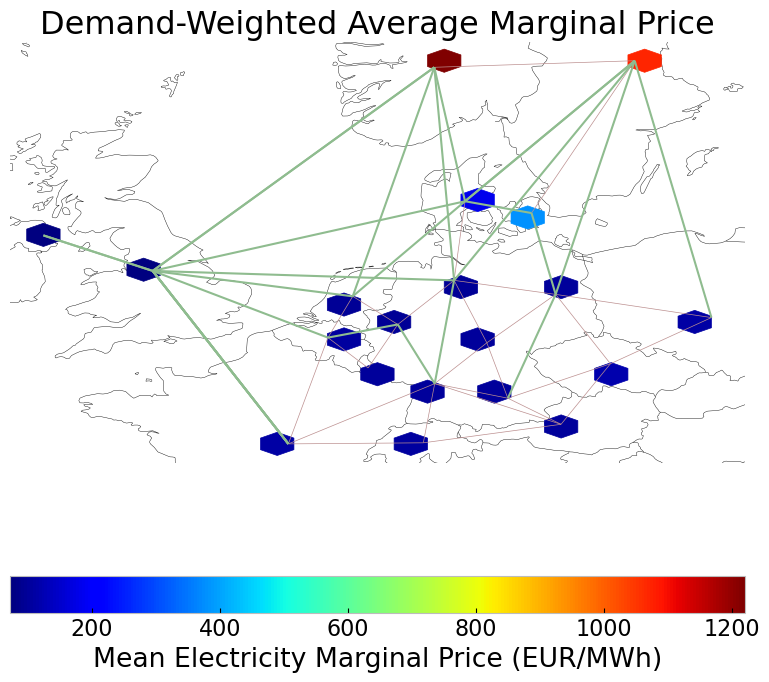

In [75]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4,'2030-01-01 00:00','2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [76]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

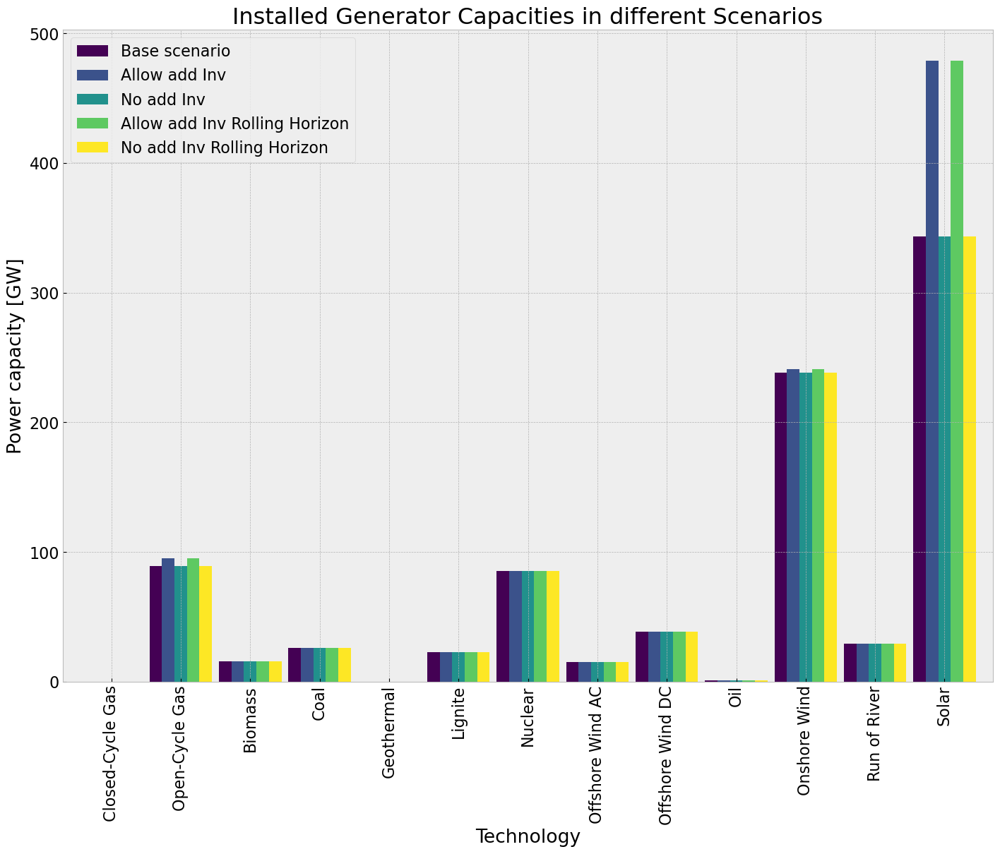

In [77]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


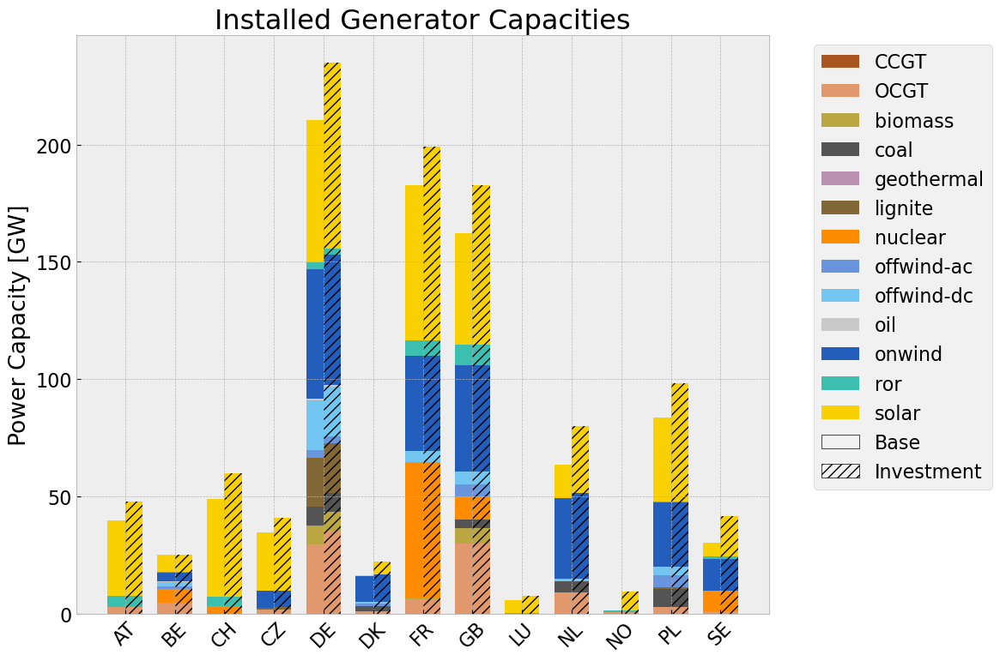

In [78]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

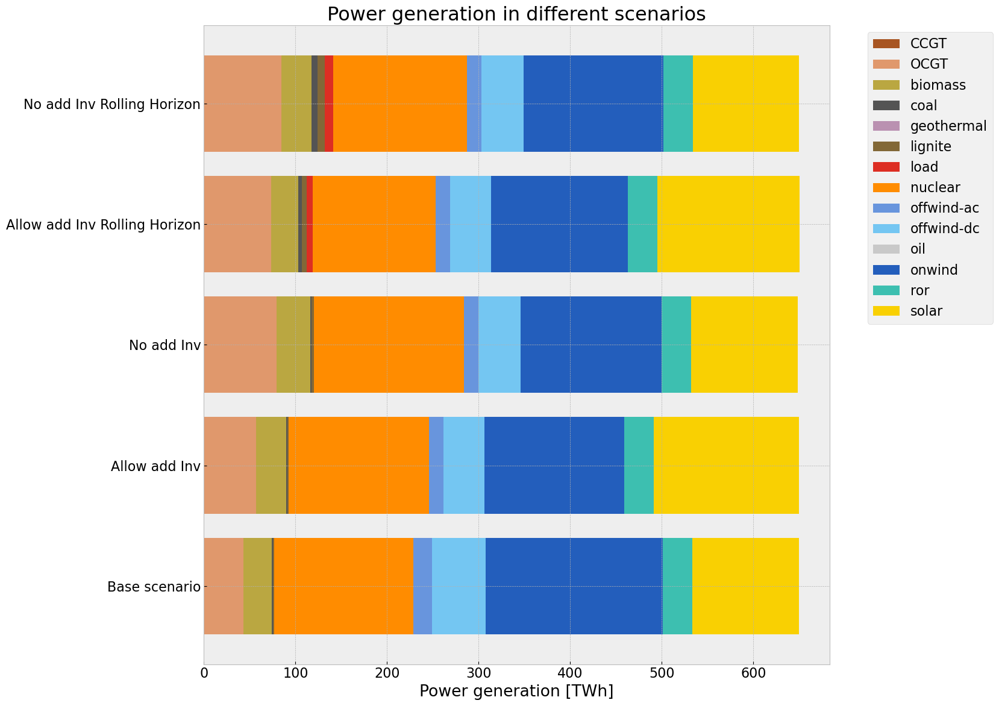

In [79]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

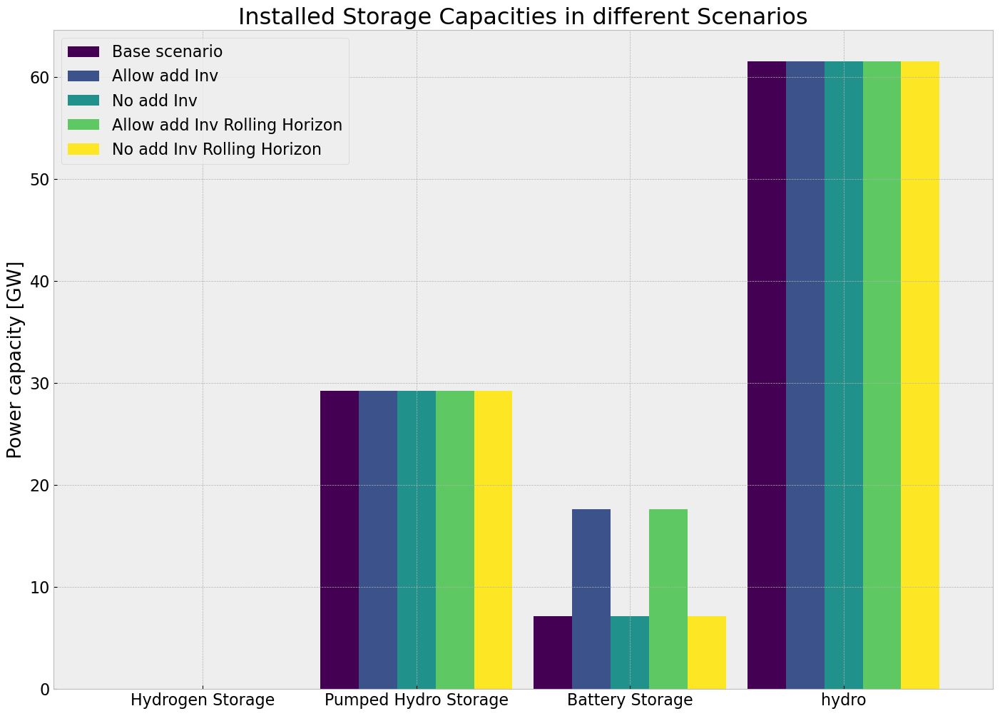

In [80]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

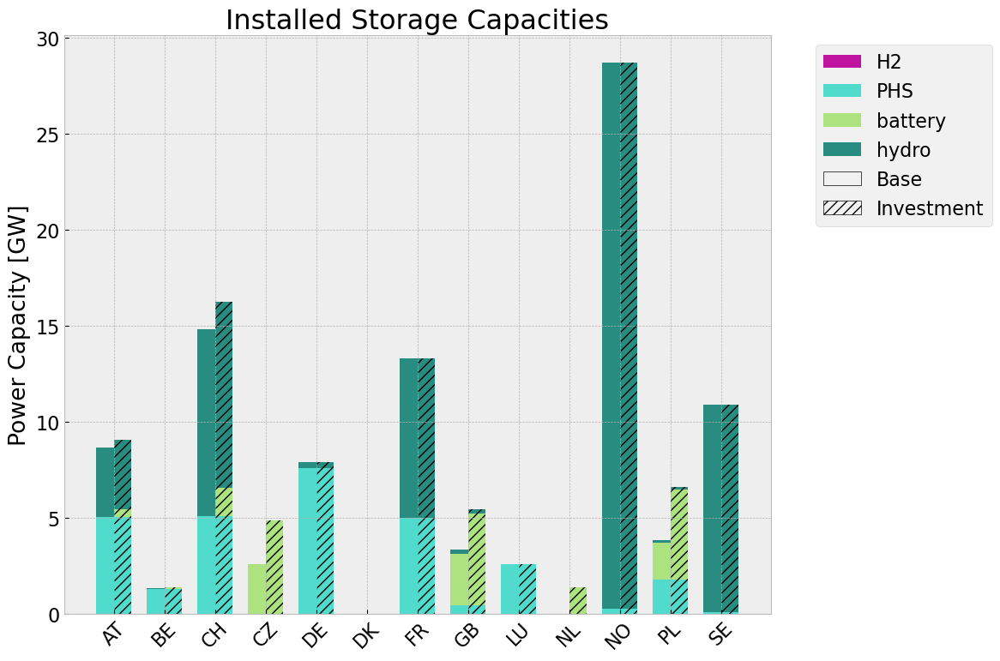

In [81]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [82]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a

comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


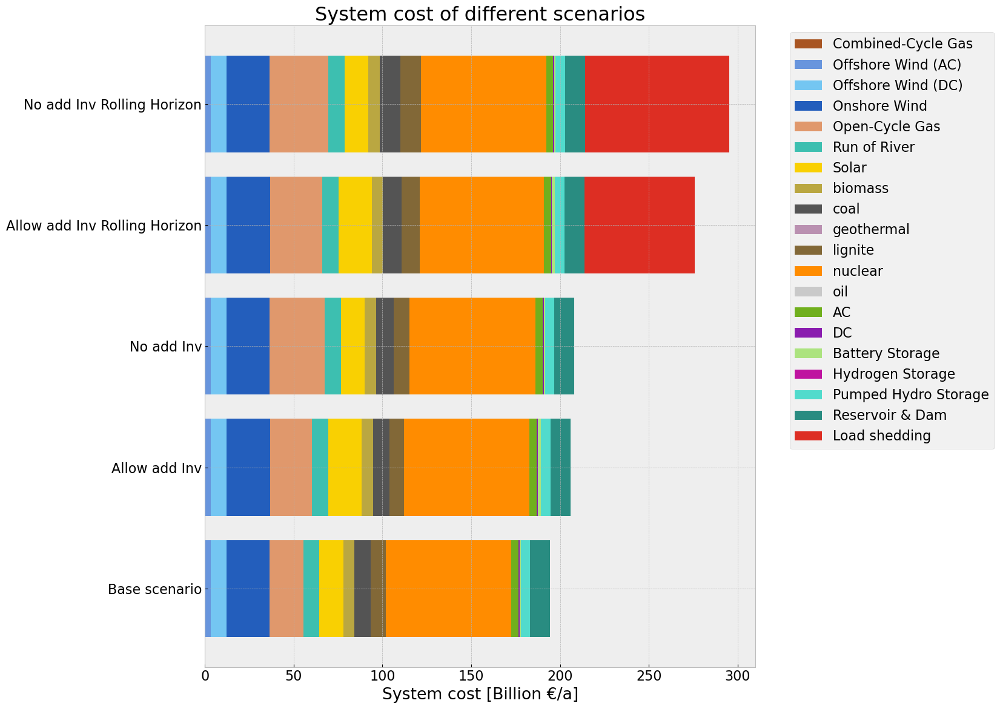

In [83]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [84]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [85]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


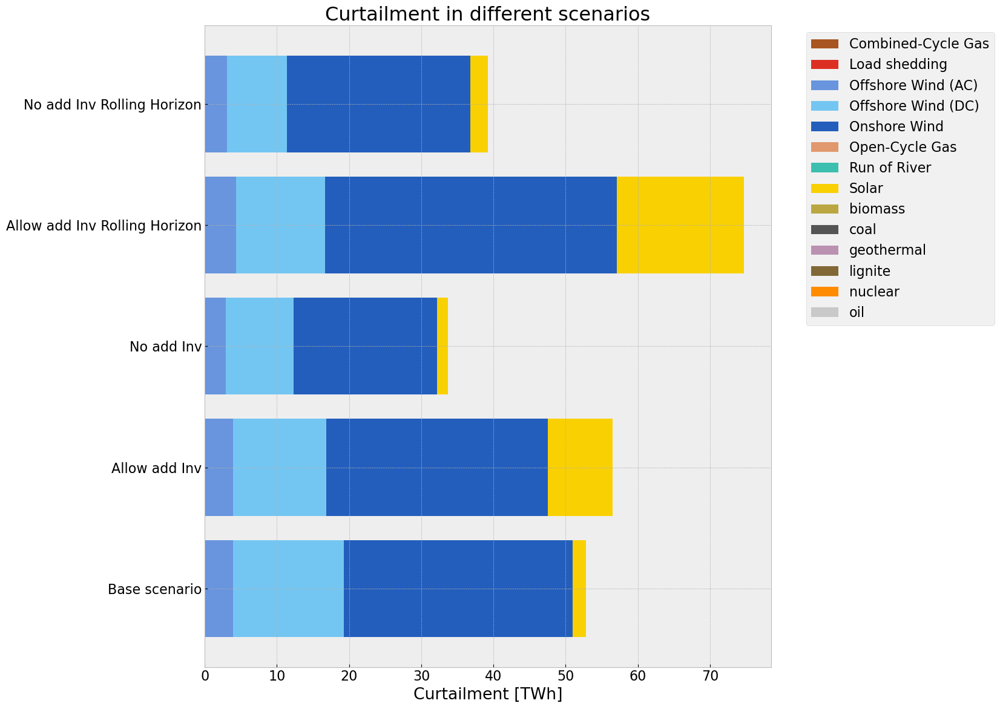

In [86]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\1032422005.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


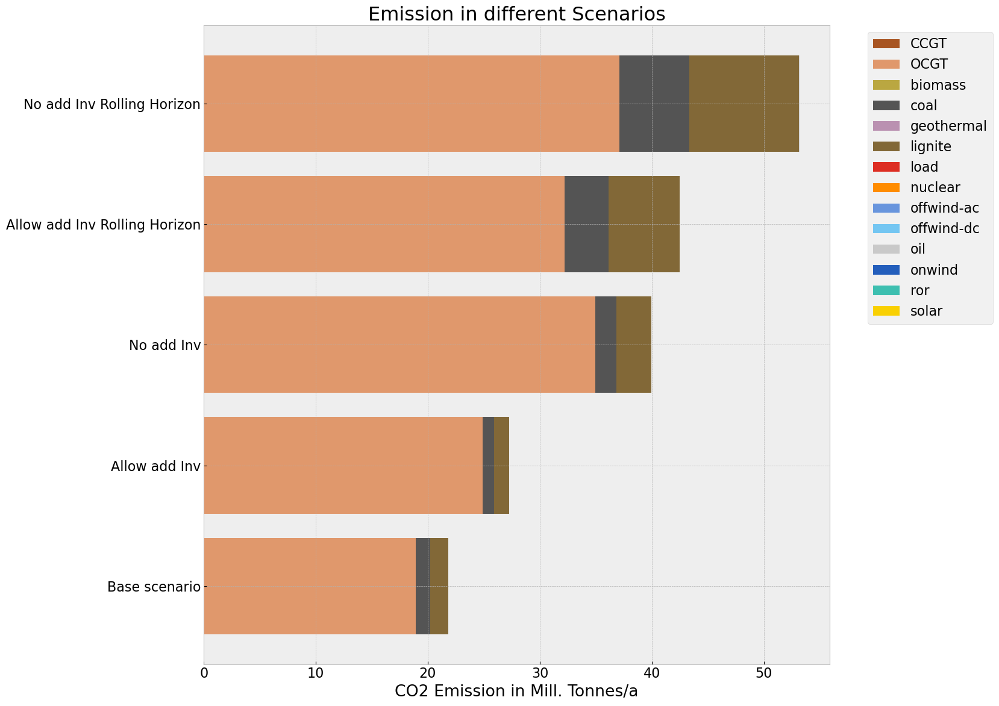

In [87]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [88]:
models = [n, n1, n2, n3, n4]

In [89]:
for m in models:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

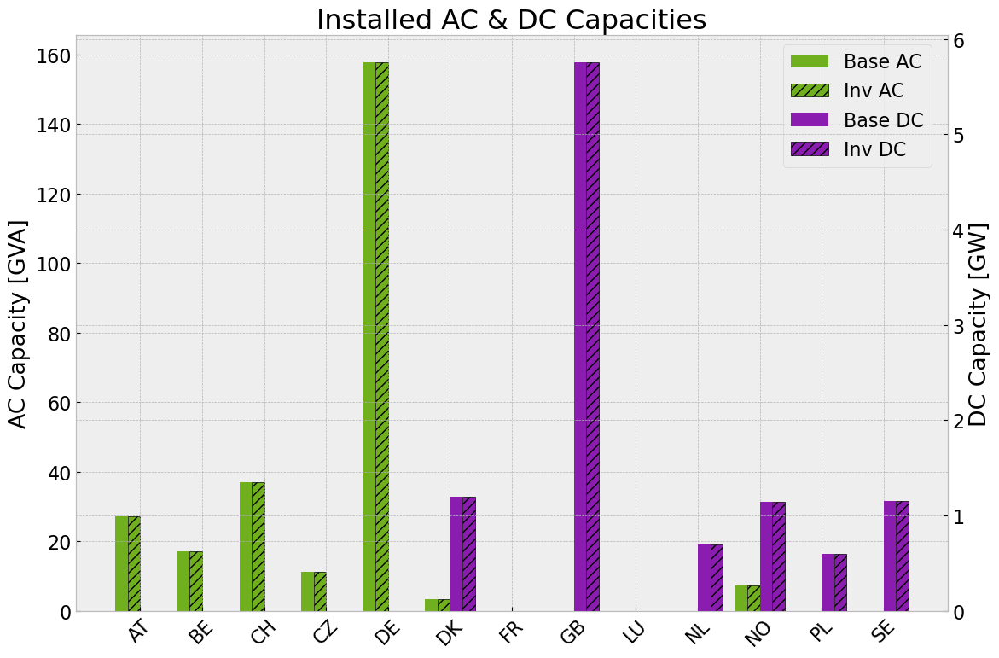

In [90]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_wind.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_wind.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_wind.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_wind.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_wind.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_wind.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

# Sensitivity Analysis

In [91]:
sens_reductionto = [0.75, reductionto, 0.25]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

In [92]:
for red in sens_reductionto:
    for dur in sens_duration:
        print(red, dur)

0.75 90
0.75 180
0.75 270
0.5 90
0.5 180
0.5 270
0.25 90
0.25 180
0.25 270


#### Create and Solve Models

In [93]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [94]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = windscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = windscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_75_90_inv


INFO:pypsa.io:Imported network n_0_75_90_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_90_inv_roll


INFO:pypsa.io:Imported network n_0_75_90_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_90_noinv


INFO:pypsa.io:Imported network n_0_75_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_90_noinv_roll


INFO:pypsa.io:Imported network n_0_75_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_180_inv


INFO:pypsa.io:Imported network n_0_75_180_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_180_inv_roll


INFO:pypsa.io:Imported network n_0_75_180_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_180_noinv


INFO:pypsa.io:Imported network n_0_75_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_180_noinv_roll


INFO:pypsa.io:Imported network n_0_75_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_270_inv


INFO:pypsa.io:Imported network n_0_75_270_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_270_inv_roll


INFO:pypsa.io:Imported network n_0_75_270_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_270_noinv


INFO:pypsa.io:Imported network n_0_75_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_75_270_noinv_roll


INFO:pypsa.io:Imported network n_0_75_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_inv


INFO:pypsa.io:Imported network n_0_5_90_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_inv_roll


INFO:pypsa.io:Imported network n_0_5_90_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv


INFO:pypsa.io:Imported network n_0_5_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_90_noinv_roll


INFO:pypsa.io:Imported network n_0_5_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv


INFO:pypsa.io:Imported network n_0_5_270_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_inv_roll


INFO:pypsa.io:Imported network n_0_5_270_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv


INFO:pypsa.io:Imported network n_0_5_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_5_270_noinv_roll


INFO:pypsa.io:Imported network n_0_5_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv


INFO:pypsa.io:Imported network n_0_25_90_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_inv_roll


INFO:pypsa.io:Imported network n_0_25_90_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_noinv


INFO:pypsa.io:Imported network n_0_25_90_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_90_noinv_roll


INFO:pypsa.io:Imported network n_0_25_90_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_180_inv


INFO:pypsa.io:Imported network n_0_25_180_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_180_inv_roll


INFO:pypsa.io:Imported network n_0_25_180_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_180_noinv


INFO:pypsa.io:Imported network n_0_25_180_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_180_noinv_roll


INFO:pypsa.io:Imported network n_0_25_180_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_inv


INFO:pypsa.io:Imported network n_0_25_270_inv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_inv_roll


INFO:pypsa.io:Imported network n_0_25_270_inv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_noinv


INFO:pypsa.io:Imported network n_0_25_270_noinv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


n_0_25_270_noinv_roll


INFO:pypsa.io:Imported network n_0_25_270_noinv_roll.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [95]:
n_0_25_180_noinv.generators_t.p_max_pu.loc['2013-02-01 00:00']

Generator
AT1 0 onwind        0.091542
AT1 0 ror           0.337938
AT1 0 solar         0.000000
BE1 0 offwind-ac    0.221375
BE1 0 offwind-dc    0.221375
BE1 0 onwind        0.193922
BE1 0 ror           0.949513
BE1 0 solar         0.000000
CH1 0 onwind        0.070660
CH1 0 ror           0.133104
CH1 0 solar         0.000000
CZ1 0 onwind        0.206845
CZ1 0 solar         0.000000
DE1 0 onwind        0.226745
DE1 0 ror           1.000000
DE1 0 solar         0.000000
DE1 1 offwind-ac    0.221375
DE1 1 offwind-dc    0.221315
DE1 1 onwind        0.210203
DE1 1 ror           1.000000
DE1 1 solar         0.000000
DE1 2 onwind        0.224304
DE1 2 ror           1.000000
DE1 2 solar         0.000000
DE1 3 onwind        0.175332
DE1 3 ror           0.722736
DE1 3 solar         0.000000
DE1 4 offwind-ac    0.221375
DE1 4 offwind-dc    0.203318
DE1 4 onwind        0.248532
DE1 4 ror           1.000000
DE1 4 solar         0.000000
DE1 5 offwind-ac    0.221375
DE1 5 offwind-dc    0.221375
DE1 

In [96]:
# import initial models (n1-n4) and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = f'inv_{contingency}.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = f'noinv_{contingency}.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = f'noinv_roll_{contingency}.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = f'inv_roll_{contingency}.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_wind.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [97]:
senscost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
senscost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
    
        senscost_df.loc[red,dur] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

KeyError: 'system_cost_n_0_75_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_75_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_75_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()


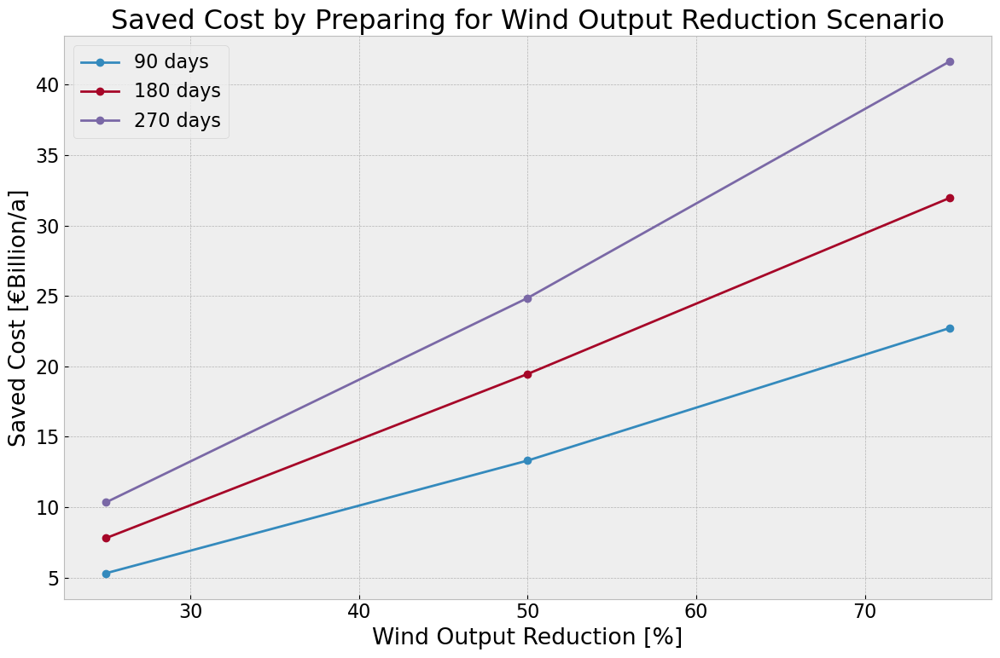

In [98]:
#rename index
new_index = [(x - 1) * -100 for x in sens_reductionto]
senscost_df.index = new_index

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in senscost_df.columns:
    ax.plot(senscost_df.index, senscost_df[column], marker='o', label=f'{column} days')

# Add labels and legend
ax.set_xlabel('Wind Output Reduction [%]')
ax.set_ylabel('Saved Cost [€Billion/a]')
ax.set_title('Saved Cost by Preparing for Wind Output Reduction Scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [99]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [100]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [101]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.765798178079722' has dtype incompatible with int64, ple

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

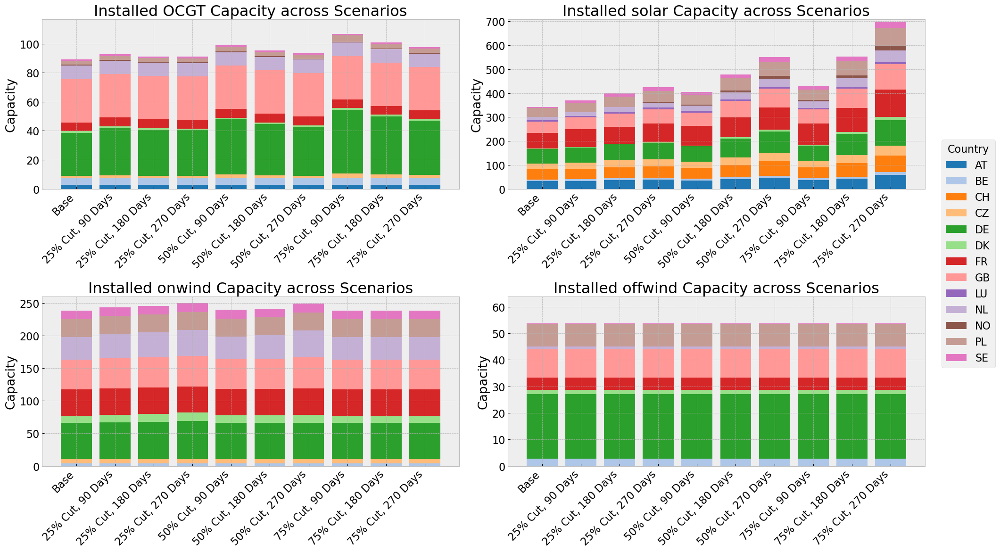

In [102]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [103]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

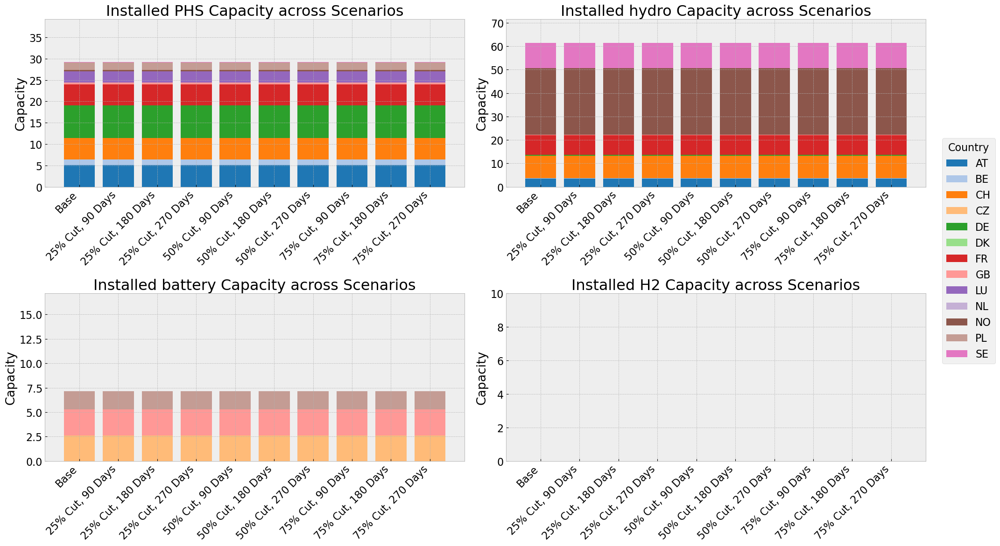

In [104]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [105]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_wind.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3755347537.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_wind.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3755347537.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_wind.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3755347537.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.91138834993883' has dtype inco

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_2712\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


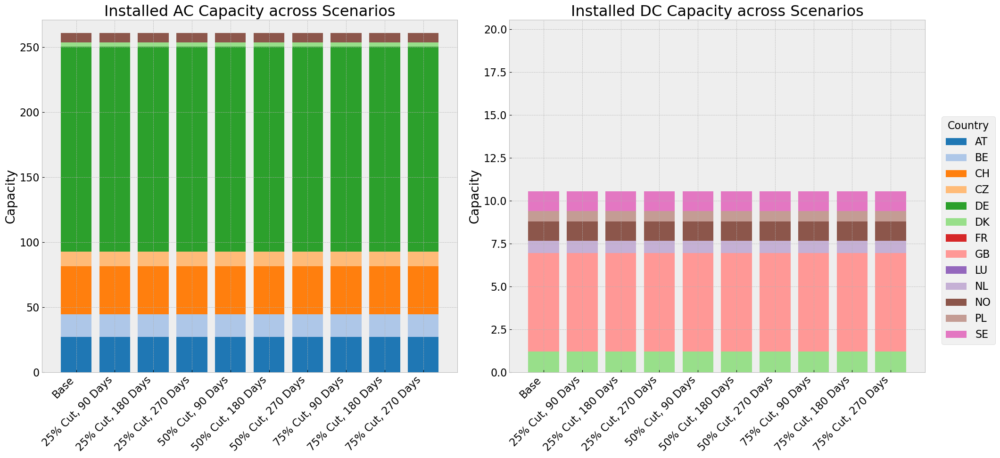

In [106]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()